# Анализ комментариев Социальных сетей и представление графовых данных

## Работа студентов группы AIN-1-21
###   Югай Ильи
###   Голощапова Николая
###   Токторбаев Айдар
###   Курбанов Джурат


In [1]:
!pip install graphistry


[notice] A new release of pip available: 22.3.1 -> 23.3.2
[notice] To update, run: python.exe -m pip install --upgrade pip


In [1]:
!pip install vaderSentiment


[notice] A new release of pip available: 22.3.1 -> 23.3.2
[notice] To update, run: python.exe -m pip install --upgrade pip


In [2]:
!pip install emoji


[notice] A new release of pip available: 22.3.1 -> 23.3.2
[notice] To update, run: python.exe -m pip install --upgrade pip


## Импорт библиотек

In [50]:
import pandas as pd
import numpy as np
import re
import time
import datetime
from googleapiclient import discovery
import seaborn as sns
import string
import emoji
from wordcloud import WordCloud, STOPWORDS
from nltk.corpus import stopwords
import csv
import os
from sklearn.metrics import confusion_matrix
from sklearn.metrics import classification_report
from sklearn.cluster import KMeans
import matplotlib.pyplot as plt
from nltk.corpus import stopwords
import nltk
nltk.download('stopwords')
import vaderSentiment
from vaderSentiment.vaderSentiment import SentimentIntensityAnalyzer
from textblob import TextBlob
import networkx as nx
import graphistry
import matplotlib.pyplot as plt
%matplotlib inline


[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\for_i\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


## Определение функций

In [51]:
def change_like(text):
    if type(text) == int or type(text) == float:
        return int(text)
    if text.lower() == 'reply':
        return 0
    if 'likes' in text:
        return int(text.replace('likes', '').replace(',', ''))
    return 1


def convert_string(text):
    new_text = ''
    for char in text:
        if char not in '‘’“”´£' and char not in string.ascii_letters :
            new_text += chr(ord(char)-120205)
        else:
            new_text += char
    return new_text


def striphtml(data):
    p = re.compile(r'<.*?>')
    return p.sub('', data)


def remove_url(stringliteral):
    return re.sub(r'http\S+', '', stringliteral)


def remove_emojis(data):
    emoj = re.compile("["
        u"\U0001F600-\U0001F64F"  # emoticons
        u"\U0001F300-\U0001F5FF"  # symbols & pictographs
        u"\U0001F680-\U0001F6FF"  # transport & map symbols
        u"\U0001F1E0-\U0001F1FF"  # flags (iOS)
        u"\U00002500-\U00002BEF"  # chinese char
        u"\U00002702-\U000027B0"
        u"\U00002702-\U000027B0"
        u"\U000024C2-\U0001F251"
        u"\U0001f926-\U0001f937"
        u"\U00010000-\U0010ffff"
        u"\u2640-\u2642" 
        u"\u2600-\u2B55"
        u"\u200d"
        u"\u23cf"
        u"\u23e9"
        u"\u231a"
        u"\ufe0f"  # dingbats
        u"\u3030"
                      "]+", re.UNICODE)
    return re.sub(emoj, '', data)


def convert_emojis(text):
    return emoji.demojize(text).replace('_', ' ').replace(':', '')


def is_emojis(text):
    if emoji.demojize(text) == text:
        return False
    return True


def bad_emoji(text):
    bad_emo = '🤢💩🤡😡☠💀🖕👎🐷🐽🐖🐍🍆'
    for emoji in bad_emo:
        if emoji in text:
            return text
    return np.nan

def get_good_date(days):
        from datetime import datetime, timedelta

        # Начальная дата для Excel (1 января 1900 года)
        start_date = datetime(1900, 1, 1)

        # Конвертация дней в дату
        converted_date = start_date + timedelta(days=int(days) - 2)  # Вычитаем 2 дня из-за особенности подсчета в Excel
        formatted_date = converted_date.strftime('%d/%m/%Y')

        return formatted_date

def datetime_converter(text):


    if len(text) > 10:
        text = text[:10]
    if len(text) < 6:
        text = get_good_date(text)
    print(text)
    try:
        return datetime.datetime.strptime(text, "%Y-%m-%d")
    except:
        return datetime.datetime.strptime(text, "%d/%m/%Y")


def within_2020(datetime_obj):
    return datetime_converter('2020-01-01') <= datetime_obj <= datetime_converter('2020-12-31')


def scope_date(df, date_time='datetime'):
    df[date_time] = df[date_time].apply(datetime_converter)
    df = df[df[date_time].apply(within_2020)]
    return df


stop = stopwords.words('english')
def clean_text_round1(text):
    '''Make text lowercase, remove punctuation and remove words containing numbers.'''
    text = text.lower()
    text = re.sub('[%s]' % re.escape(string.punctuation), '', text)
    text = re.sub('\w*\d\w*', '', text)
    return text


def clean_text_round2(text):
    return ' '.join([word for word in text.split() if word not in (stop)])


def count_words_from_dataframe(df):
    result_dict = {}
    for index, row in df.iterrows():
        text = row['clean_text_1']
        tokens = text.split()
        for token in tokens:
            try:
                result_dict[token] += 1
            except KeyError:
                result_dict[token] = 1
    return result_dict


def read_word_count_file(file_path):
    with open(file_path, mode='r', encoding='utf-8') as infile:
        reader = csv.reader(infile)
        counts = {rows[0]: float(rows[1]) for rows in reader if rows}
    return counts


def makeImage(termDict, outputfile):
    wc = WordCloud(max_font_size=60, width=1280, height=720, background_color="white")    
    wc.generate_from_frequencies(termDict)
    wc.to_file(outputfile+".png")
    wc.to_file(outputfile+".pdf")
    plt.imshow(wc, interpolation="bilinear")
    plt.axis("off")
    plt.show() 


def combine_dataframe(platform, reference_list):
    frames = []
    if platform == 'instagram':
        for insta_handle in reference_list:
            filename = f'{platform}/{insta_handle[1:]}_comments.csv'
            df = pd.read_csv(filename).drop('Unnamed: 0', axis=1)
            df.likes = df.likes.apply(lambda x: x if type(x) == float else x[0] if x[0].isdigit() else 0)
            df['celeb'] = reference_list[insta_handle]
            frames.append(df)        
        df = pd.concat(frames)
        df['platform'] = platform
        df = df[['username', 'datetime', 'comment', 'likes', 'celeb', 'platform']]
    
    elif platform == 'twitter':
        for name in reference_list:
            df = pd.read_csv(f'{platform}/{name}').drop('Unnamed: 0', axis=1)
            df = pd.DataFrame({'username': df.username, 'datetime': df.date, 'comment': df.text, 'likes': df.retweet_count, 'celeb': df.name_of_celeb, 'platform': platform})
            frames.append(df)
        df = pd.concat(frames)
    
    elif platform == 'youtube':
        for name in reference_list:
            try:  
                df = pd.read_excel(f'{platform}/{name}.xlsx', sheet_name=[1,2,3])
            except:
                continue
            df = pd.concat(df.values())
            df = pd.DataFrame({'username': df.Name, 'datetime': df.Time, 'comment': df.Comment, 'likes': df.Likes, 'celeb': name, 'platform': platform})
            frames.append(df)
        df = pd.concat(frames)
    
    elif platform == 'reddit':
        for name in reference_list:
            if name == 'Janelle%20Monáe':
                name = 'Janelle%20Mon%C3%A1e'
            df = pd.read_csv(f'{platform}/{platform}_{name}.csv')
            df = pd.DataFrame({'username': df.SubmissionID, 'datetime': df.Timestamp, 'comment': df.Comment, 'likes': 0, 'celeb': name, 'platform': platform})
            frames.append(df)
        df = pd.concat(frames)
    
    elif platform == 'facebook':
        df = pd.read_csv(f'{platform}/FB_Celebs.csv')
        df = pd.DataFrame({'username': df.object_id, 'datetime': df.created_time, 'comment': df.message, 'likes': df.like_count, 'celeb': df.celeb, 'platform': platform})

    return df


def add_columns(df):
    attribute_list = ["TOXICITY","SEVERE_TOXICITY","IDENTITY_ATTACK","INSULT","PROFANITY","THREAT","SEXUALLY_EXPLICIT","FLIRTATION"]
    for attri in attribute_list:
        df[attri] = np.nan
    return df


def calculate_toxicity_percentage(df, col):
    not_toxic, toxic = df[df.platform == "twitter"][col].value_counts()
    twitter_toxic_percentage = toxic/(not_toxic+toxic)*100

    not_toxic, toxic = df[df.platform == "youtube"][col].value_counts()
    youtube_toxic_percentage = toxic/(not_toxic+toxic)*100

    not_toxic, toxic = df[df.platform == "facebook"][col].value_counts()
    facebook_toxic_percentage = toxic/(not_toxic+toxic)*100

    not_toxic, toxic = df[df.platform == "instagram"][col].value_counts()
    instagram_toxic_percentage = toxic/(not_toxic+toxic)*100

    not_toxic, toxic = df[df.platform == "reddit"][col].value_counts()
    reddit_toxic_percentage = toxic/(not_toxic+toxic)*100

    return (youtube_toxic_percentage, instagram_toxic_percentage, reddit_toxic_percentage, facebook_toxic_percentage, twitter_toxic_percentage)

# Обработка датасета


### Очистка датасета


In [12]:
import pandas as pd

csv_file_path = 'comments_not_label.csv'
data = pd.read_csv(csv_file_path, skipinitialspace=True)

required_columns = [
    "username", "datetime", "comment", "likes", "celeb", "platform",
    "TOXICITY", "SEVERE_TOXICITY", "SEXUALLY_EXPLICIT", "THREAT",
    "INSULT", "IDENTITY_ATTACK"
]

data = data[required_columns]


output_file_path = 'cleaned_comments.csv'
data.to_csv(output_file_path, index=False, quoting=2)


output_file_path


'cleaned_comments.csv'

### С использованием модели multilabel_toxicity_model2.pkl мы запускаем проставление лейблов комментариям в датасете

In [80]:
import pandas as pd
import joblib

# Загрузка обученной модели мультилейбл классификации
model_path = 'multilabel_toxicity_model2.pkl'
model = joblib.load(model_path)

# Загрузка данных, которые были предварительно очищены
cleaned_data_path = 'cleaned_comments.csv'
cleaned_data = pd.read_csv(cleaned_data_path)

# Очищаем колонку от нулевых значений
cleaned_data.dropna(subset=['comment'], inplace=True)

# Получение вероятностей с помощью модели
predicted_probabilities = model.predict_proba(cleaned_data['comment'].astype(str))

# Имена столбцов для предсказаний
label_columns = ["TOXICITY", "SEVERE_TOXICITY", "SEXUALLY_EXPLICIT", "THREAT", "INSULT", "IDENTITY_ATTACK"]

# Замените существующие колонки предсказанными вероятностями
for i, column in enumerate(label_columns):
    # Для каждой метки, берем второй элемент (вероятность класса 1) из каждого предсказания
    cleaned_data[column] = [proba[1] for proba in predicted_probabilities[i]]

# Сохраните результаты в новый CSV-файл
cleaned_data.to_csv('comments_labelled.csv', index=False, quoting=2)


## Чтение готового датасета с проставленными метками

In [81]:
df = pd.read_csv('comments_labelled.csv', quoting=2, skipinitialspace=True)
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1629048 entries, 0 to 1629047
Data columns (total 12 columns):
 #   Column             Non-Null Count    Dtype  
---  ------             --------------    -----  
 0   username           1629048 non-null  object 
 1   datetime           1629048 non-null  object 
 2   comment            1629048 non-null  object 
 3   likes              1629048 non-null  float64
 4   celeb              1629048 non-null  object 
 5   platform           1629048 non-null  object 
 6   TOXICITY           1629048 non-null  float64
 7   SEVERE_TOXICITY    1629048 non-null  float64
 8   SEXUALLY_EXPLICIT  1629048 non-null  float64
 9   THREAT             1629048 non-null  float64
 10  INSULT             1629048 non-null  float64
 11  IDENTITY_ATTACK    1629048 non-null  float64
dtypes: float64(7), object(5)
memory usage: 149.1+ MB


## Анализ данных полученных из comments_labelled

In [82]:
set(df['platform'].tolist())

{'facebook', 'instagram', 'reddit', 'twitter', 'youtube'}

In [83]:
# добавляем comment_type для общей оценки токсичности
df['comment_type'] = df[['TOXICITY', 'SEVERE_TOXICITY', 'SEXUALLY_EXPLICIT', 'THREAT', 'INSULT', 'IDENTITY_ATTACK']].sum(axis=1)
df['comment_type'] = df['comment_type'].apply(lambda x: 'TOXIC' if x >= 1 else 'NOT TOXIC')
df['comment_type_n'] = df[['TOXICITY', 'SEVERE_TOXICITY', 'SEXUALLY_EXPLICIT', 'THREAT', 'INSULT', 'IDENTITY_ATTACK']].sum(axis=1)


In [84]:
df.head()

,username,datetime,comment,likes,celeb,platform,TOXICITY,SEVERE_TOXICITY,SEXUALLY_EXPLICIT,THREAT,INSULT,IDENTITY_ATTACK,comment_type,comment_type_n
0,pierrearden_team_gelord,2020-09-15,Hey Ben great feed we'd like to organise a c...,1.0,Ben Platt,instagram,0.084297,0.009970,0.059254,0.006657,0.052305,0.015842,NOT TOXIC,0.228326
1,ophelielaplante,2020-09-19,@_shxniex_,1.0,Ben Platt,instagram,0.074854,0.009280,0.029988,0.002659,0.033007,0.008690,NOT TOXIC,0.158479
2,dr_wsutton,2020-09-27,So fucking sexy @bensplatt,0.0,Ben Platt,instagram,0.996650,0.232224,0.998171,0.014383,0.749580,0.068883,TOXIC,3.059891
3,pwpmccormack,2020-10-26,Cute,0.0,Ben Platt,instagram,0.036114,0.009651,0.031015,0.002535,0.022941,0.007413,NOT TOXIC,0.109670
4,bby.joker_,2020-10-29,@lordemusic 🥀✨ @ellamai @palomamami @sza,0.0,Ben Platt,instagram,0.074854,0.009280,0.029988,0.002659,0.033007,0.008690,NOT TOXIC,0.158479


## Вывод токсичности по соц сетям

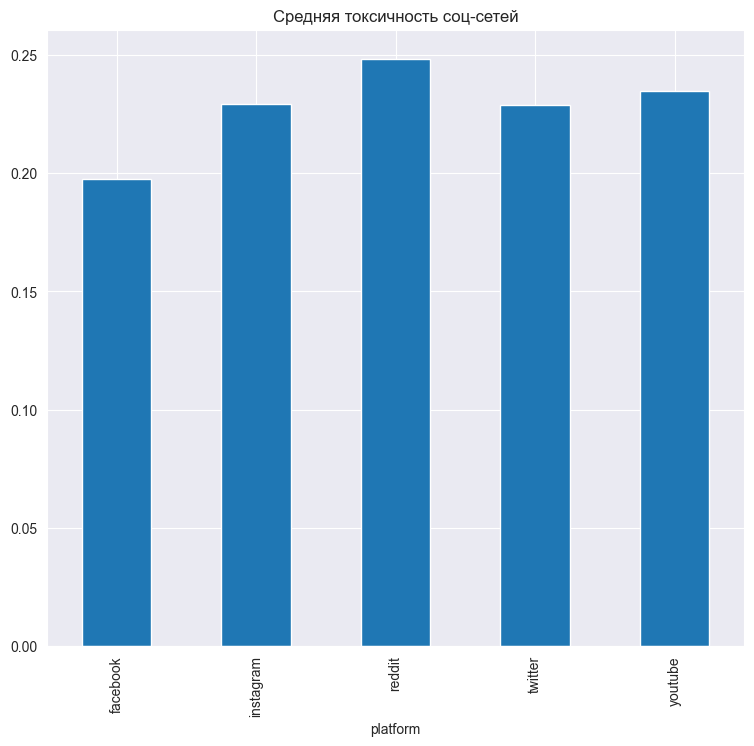

In [85]:
df.groupby('platform')\
    .comment_type_n\
    .mean()\
    .plot(kind='bar', title='Средняя токсичность соц-сетей', figsize=(9,8))\
    .get_figure()\
    .savefig('images/Mean Toxicity of each platform')

## Количество Токсичных комментариев по соц сетям

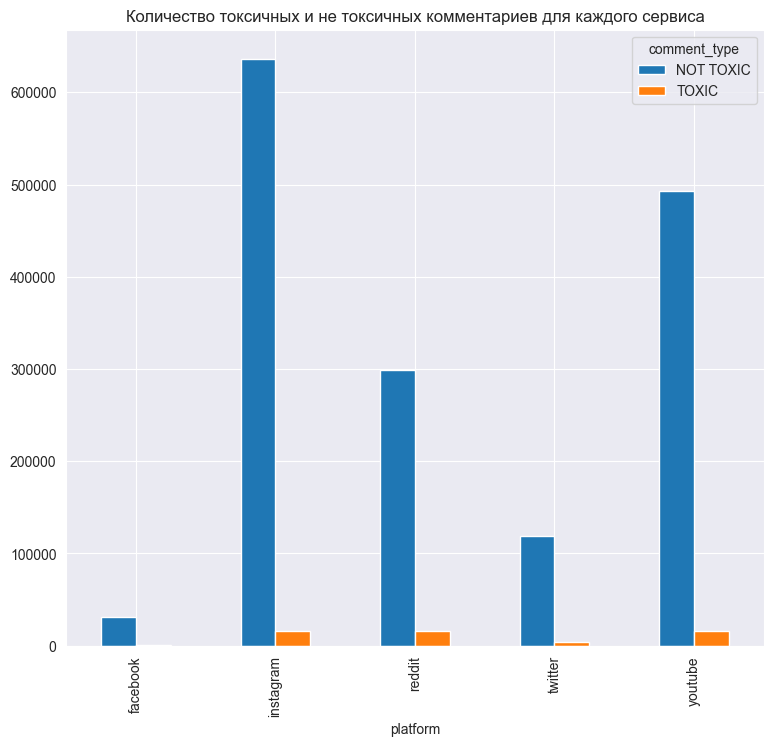

In [86]:
counts = df.groupby('platform')['comment_type'].value_counts().reset_index(name='num')

# Создание сводной таблицы и построение графика
pivot_table = counts.pivot(index='platform', columns='comment_type', values='num')
plot = pivot_table.plot(kind='bar', figsize=(9, 8), title='Количество токсичных и не токсичных комментариев для каждого сервиса')
fig = plot.get_figure()
fig.savefig('Num_Toxic_and_Non_Toxic_Comments_for_Each_Platform.png')


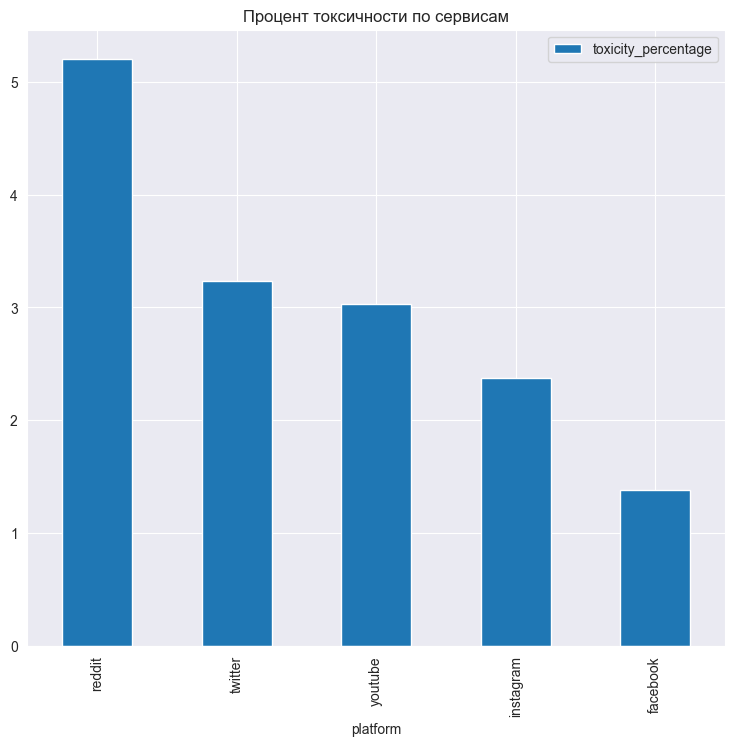

In [87]:
pd.DataFrame({'platform': ['youtube', 'instagram', 'reddit', 'facebook', 'twitter'],
            'toxicity_percentage': calculate_toxicity_percentage(df, 'comment_type')})\
            .sort_values('toxicity_percentage', ascending=False)\
            .plot(x='platform', kind='bar', title='Процент токсичности по сервисам', figsize=(9,8))\
            .get_figure()\
            .savefig('images/Toxicity Percentage for each platform')

## BoxPlot

In [88]:
df['length'] = df.comment.apply(str.split).apply(len)

In [89]:
# Убедитесь, что 'datetime' преобразован в строку
df['datetime'] = df['datetime'].astype(str)

# Создание словаря с уникальными датами
unique_dates = sorted(df['datetime'].unique())
date_dict = {date: i + 1 for i, date in enumerate(unique_dates)}

# Проверка, что все даты включены
print("Количество уникальных дат:", len(unique_dates))

# Применение словаря
df['datenum'] = df['datetime'].apply(lambda x: date_dict.get(x, -1))  # используйте -1 или другое значение для неизвестных дат

# Проверьте, есть ли несоответствия
print("Количество несоответствий:", df[df['datenum'] == -1].shape[0])


Количество уникальных дат: 1746
Количество несоответствий: 0


## Kernal Density Estimate plot

In [90]:

df.datetime = df.datetime.apply(datetime_converter)
df['ordinal'] = [x.toordinal() for x in df.datetime]


2020-09-15
2020-09-19
2020-09-27
2020-10-26
2020-10-29
2020-12-10
2021-01-23
2021-03-29
2021-05-17
2021-06-10
2021-07-21
2021-07-27
2020-02-24
2020-03-16
2020-03-18
2020-03-31
2020-04-04
2020-04-16
2020-04-25
2020-05-07
2020-05-11
2020-05-11
2020-05-11
2020-05-11
2020-01-23
2020-01-23
2020-01-26
2020-01-27
2020-01-28
2020-01-30
2020-02-07
2020-02-09
2020-02-09
2020-02-13
2020-02-13
2020-02-17
2020-01-18
2020-01-19
2020-01-20
2020-01-20
2020-01-20
2020-01-20
2020-01-20
2020-01-20
2020-01-21
2020-01-21
2020-01-21
2020-01-22
2020-01-13
2020-01-13
2020-01-15
2020-01-15
2020-01-16
2020-01-16
2020-01-16
2020-01-16
2020-01-17
2020-01-17
2020-01-17
2020-01-18
2020-01-11
2020-01-11
2020-01-11
2020-01-11
2020-01-11
2020-01-11
2020-01-12
2020-01-13
2020-01-13
2020-01-13
2020-01-13
2020-01-13
2020-01-09
2020-01-10
2020-01-10
2020-01-10
2020-01-10
2020-01-10
2020-01-10
2020-01-10
2020-01-10
2020-01-10
2020-01-10
2020-01-10
2020-01-08
2020-01-08
2020-01-08
2020-01-08
2020-01-08
2020-01-09
2020-01-09

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)




2020-09-30
2020-09-30
2020-09-27
2020-09-27
2020-09-27
2020-09-28
2020-09-28
2020-09-28
2020-09-28
2020-09-28
2020-09-28
2020-09-28
2020-09-28
2020-09-28
2020-09-26
2020-09-26
2020-09-26
2020-09-26
2020-09-26
2020-09-26
2020-09-26
2020-09-26
2020-09-26
2020-09-26
2020-09-27
2020-09-27
2020-09-25
2020-09-25
2020-09-25
2020-09-25
2020-09-25
2020-09-25
2020-09-25
2020-09-25
2020-09-25
2020-09-25
2020-09-25
2020-09-26
2020-09-24
2020-09-24
2020-09-24
2020-09-25
2020-09-25
2020-09-25
2020-09-25
2020-09-25
2020-09-25
2020-09-25
2020-09-25
2020-09-25
2020-09-24
2020-09-24
2020-09-24
2020-09-24
2020-09-24
2020-09-24
2020-09-24
2020-09-24
2020-09-24
2020-09-24
2020-09-24
2020-09-24
2020-09-24
2020-09-24
2020-09-24
2020-09-24
2020-09-24
2020-09-24
2020-09-24
2020-09-24
2020-09-24
2020-09-24
2020-09-24
2020-09-23
2020-09-23
2020-09-23
2020-09-23
2020-09-23
2020-09-23
2020-09-23
2020-09-23
2020-09-23
2020-09-23
2020-09-24
2020-09-24
2020-09-23
2020-09-23
2020-09-23
2020-09-23
2020-09-23
2020-09-2

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21
2021-05-21

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



2021-04-03
2021-04-03
2021-04-03
2021-04-03
2021-04-03
2021-04-03
2021-04-03
2021-04-03
2021-04-03
2021-04-03
2021-04-03
2021-04-03
2021-04-03
2021-04-03
2021-04-03
2021-04-03
2021-04-03
2021-04-03
2021-04-03
2021-04-03
2021-04-03
2021-04-03
2021-04-03
2021-04-03
2021-04-03
2021-04-03
2021-04-03
2021-04-03
2021-04-03
2021-04-03
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-02
2021-04-01
2021-04-01
2021-04-01
2021-04-01
2021-04-01
2021-04-01
2021-04-01
2021-04-01
2021-04-01
2021-04-01
2021-04-01
2021-04-01
2021-04-01
2021-04-01
2021-04-01
2021-04-01
2021-04-01
2021-04-01
2021-04-01
2021-04-01
2021-04-01
2021-04-01
2021-04-01

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)




2020-10-01
2020-10-01
2020-10-01
2020-10-01
2020-10-01
2020-10-01
2020-09-30
2020-09-30
2020-09-30
2020-09-30
2020-09-30
2020-10-01
2020-09-30
2020-10-01
2020-10-01
2020-10-01
2020-09-30
2020-10-01
2020-10-01
2020-10-01
2020-10-01
2020-10-01
2020-10-01
2020-09-30
2020-10-01
2020-10-01
2020-10-01
2020-10-01
2020-10-01
2020-10-01
2020-10-01
2020-10-01
2020-10-01
2020-10-01
2020-10-01
2020-10-01
2020-10-01
2020-10-01
2020-10-01
2020-10-01
2020-10-01
2020-10-01
2020-10-01
2020-10-01
2020-10-01
2020-10-01
2020-10-01
2020-10-01
2020-10-01
2020-10-01
2020-10-01
2020-10-01
2020-10-01
2020-10-01
2020-10-01
2020-10-01
2020-10-01
2020-10-01
2020-10-01
2020-10-01
2020-10-01
2020-09-30
2020-10-01
2020-10-01
2020-10-01
2020-10-01
2020-10-01
2020-10-01
2020-10-01
2020-10-01
2020-10-01
2020-10-01
2020-10-01
2020-10-01
2020-10-01
2020-10-01
2020-10-01
2020-10-01
2020-10-01
2020-10-01
2020-10-01
2020-10-01
2020-10-01
2020-10-01
2020-10-01
2020-10-01
2020-10-01
2020-10-01
2020-10-01
2020-10-01
2020-10-0

### Что означает это?

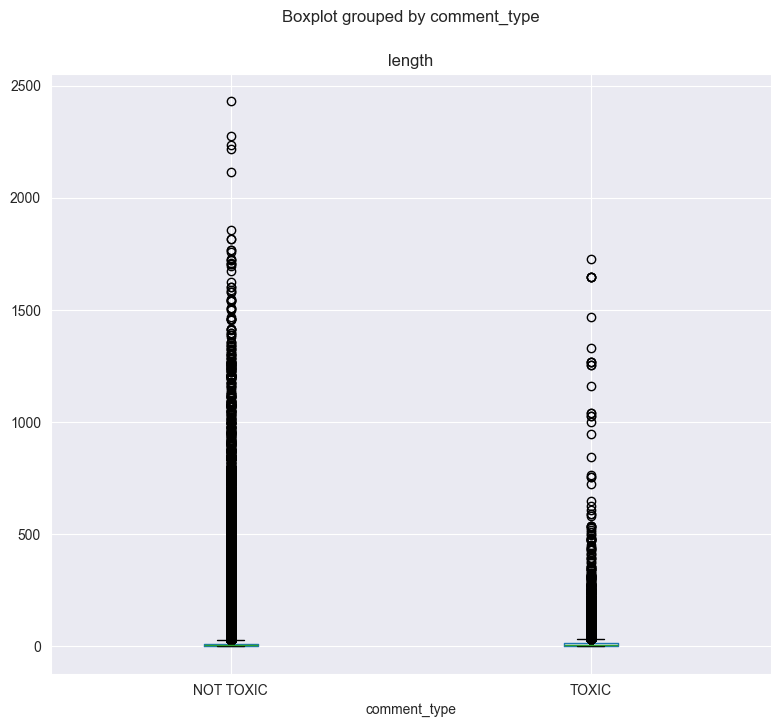

In [91]:
df.boxplot(by='comment_type',
            column=['length'],
            figsize=(9,8))\
    .get_figure()\
    .savefig('images/Boxplot сгрупперированные по comment_type')

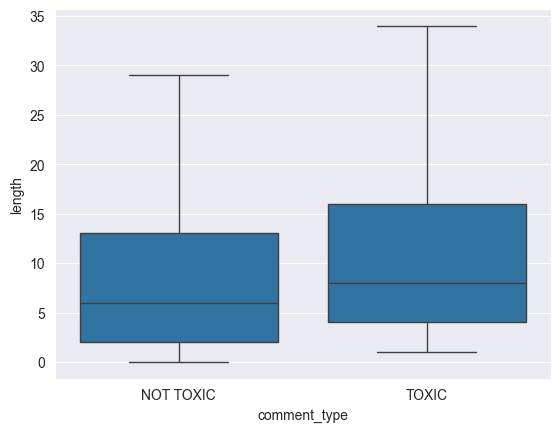

In [92]:
sns.boxplot(x=df.comment_type, y=df.length, showfliers=False)
plt.savefig('images/длина boxplot')

C:\Users\for_i\AppData\Local\Temp\ipykernel_17700\85718922.py:1: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df[df.comment_type=='TOXIC'].length, label='TOXIC')
C:\Users\for_i\AppData\Local\Temp\ipykernel_17700\85718922.py:2: UserWarning: 

`distplot` is a deprecated function and will be removed in seaborn v0.14.0.

Please adapt your code to use either `displot` (a figure-level function with
similar flexibility) or `histplot` (an axes-level function for histograms).

For a guide to updating your code to use the new functions, please see
https://gist.github.com/mwaskom/de44147ed2974457ad6372750bbe5751

  sns.distplot(df[df.comment_type=='N

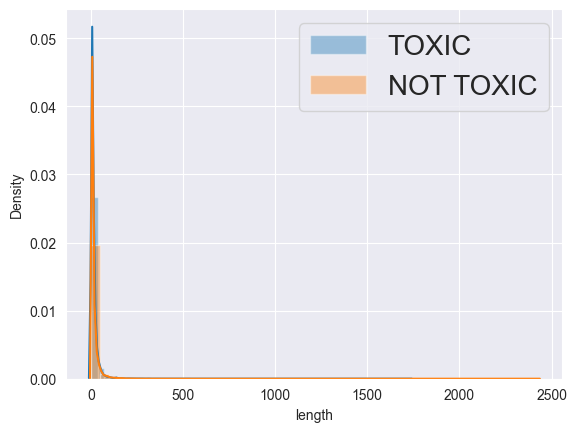

In [94]:
sns.distplot(df[df.comment_type=='TOXIC'].length, label='TOXIC')
sns.distplot(df[df.comment_type=='NOT TOXIC'].length, label='NOT TOXIC')
plt.legend(fontsize = 20)
plt.show()

### Большинство комментариев не токсичные

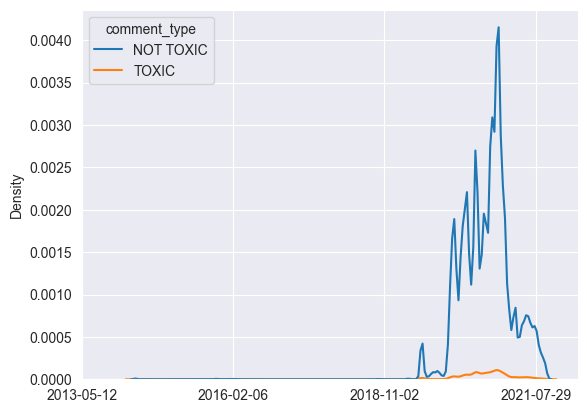

In [95]:
ax = sns.kdeplot(data=df[['comment_type', 'ordinal']].pivot(values='ordinal',columns='comment_type'))
x_ticks = ax.get_xticks()
ax.set_xticks(x_ticks[::2])
xlabels = [datetime.datetime.fromordinal(int(x)).strftime('%Y-%m-%d') for x in x_ticks[::2]]
ax.set_xticklabels(xlabels)
plt.savefig('images/KDE plot')

### Reddit в пике более токсичный по сравнению с другими сервисами

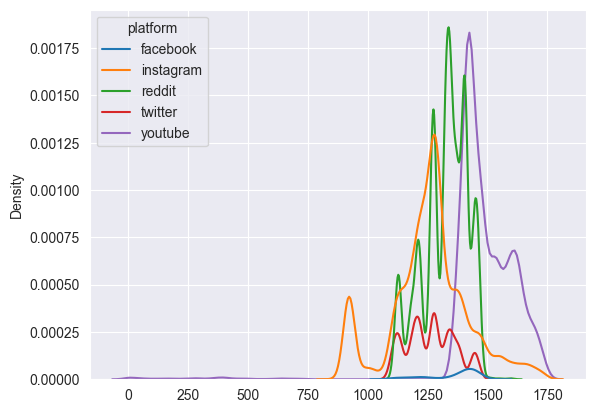

In [96]:
sns.kdeplot(data=df[df.comment_type=='TOXIC'][['platform', 'datenum']]\
                    .pivot(columns='platform', values='datenum'))
plt.savefig('images/KDE plot (Toxic comments only)')

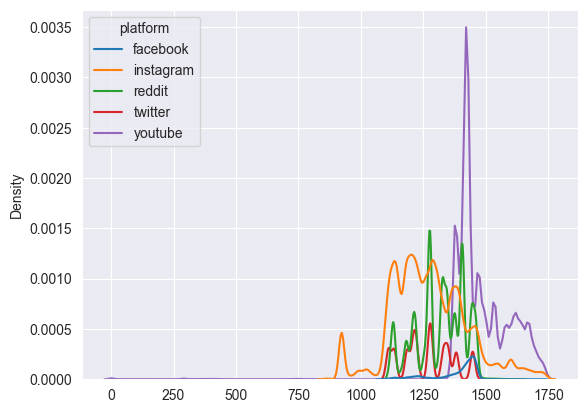

In [97]:
sns.kdeplot(data=df[df.comment_type=='NOT TOXIC'][['platform', 'datenum']]\
                    .pivot(columns='platform', values='datenum'))
plt.savefig('images/KDE plot (Non-Toxic comments only)')

In [98]:
df[df.platform=='youtube'].datetime.value_counts().sort_index()

datetime
2014-04-30     60
2014-05-01    271
2014-05-02     21
2014-05-03      7
2014-05-04      6
             ... 
2021-10-08    113
2021-10-09     86
2021-10-10     67
2021-10-11     22
2021-10-12      2
Name: count, Length: 1367, dtype: int64

## Гистограммы

### Что показывают гистограммы?

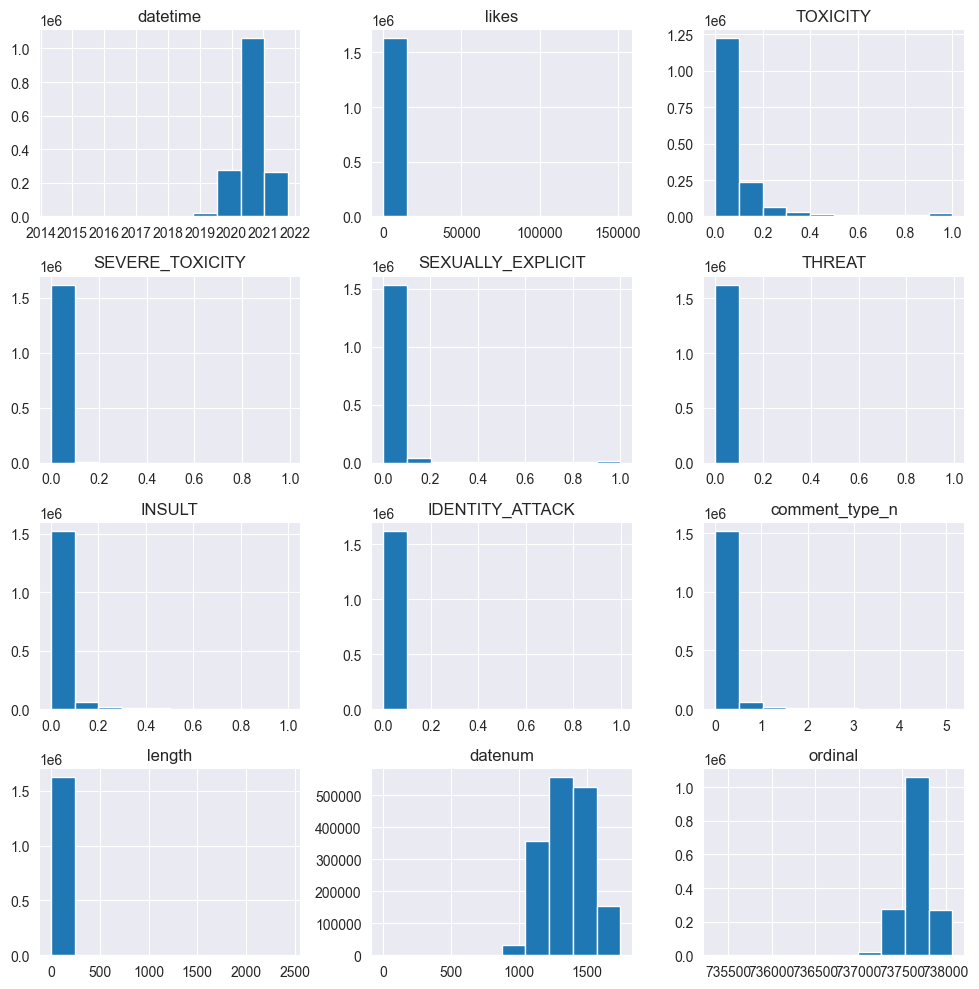

In [99]:
df.hist(figsize = (10,10))
plt.savefig('images/histogram')
plt.tight_layout()

## Корреляции с использованием тепловой карты

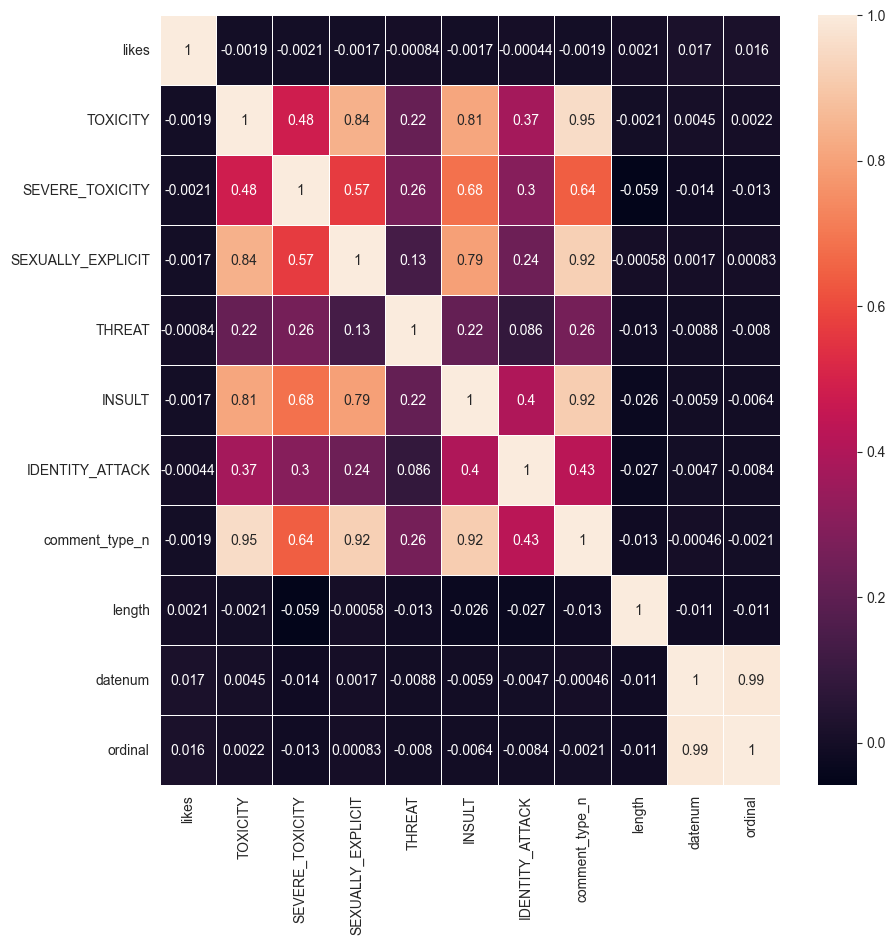

In [107]:
import matplotlib.pyplot as plt
import seaborn as sns

# Выбор только числовых столбцов из DataFrame
numeric_df = df.select_dtypes(include=[np.number])

# Создание графика корреляций
_, ax = plt.subplots(figsize=(10, 10))
sns.heatmap(numeric_df.corr(), annot=True, linewidths=.5, ax=ax)

# Сохранение графика
plt.savefig('images/correlation_heatmap.png')


## Группировка по дате и токсичности

In [106]:
df_temp = df.groupby(['datetime', 'comment_type'])\
                    ['username']\
                    .count()\
                    .reset_index(['comment_type', 'datetime'])\
                    .pivot(index='datetime', columns='comment_type', values='username')\
                    .reset_index()
df_temp

comment_type,datetime,NOT TOXIC,TOXIC
0,2014-04-30,56.0,4.0
1,2014-05-01,259.0,12.0
2,2014-05-02,19.0,2.0
3,2014-05-03,7.0,NaN
4,2014-05-04,6.0,NaN
...,...,...,...
1741,2021-10-08,233.0,1.0
1742,2021-10-09,214.0,5.0
1743,2021-10-10,150.0,7.0
1744,2021-10-11,53.0,NaN


## Соотношение токсичных комментариев на каждый день

In [108]:
df_temp['ratio'] = df_temp['TOXIC']/df_temp['NOT TOXIC']
df_temp

comment_type,datetime,NOT TOXIC,TOXIC,ratio
0,2014-04-30,56.0,4.0,0.071429
1,2014-05-01,259.0,12.0,0.046332
2,2014-05-02,19.0,2.0,0.105263
3,2014-05-03,7.0,NaN,NaN
4,2014-05-04,6.0,NaN,NaN
...,...,...,...,...
1741,2021-10-08,233.0,1.0,0.004292
1742,2021-10-09,214.0,5.0,0.023364
1743,2021-10-10,150.0,7.0,0.046667
1744,2021-10-11,53.0,NaN,NaN


<Axes: xlabel='datetime'>

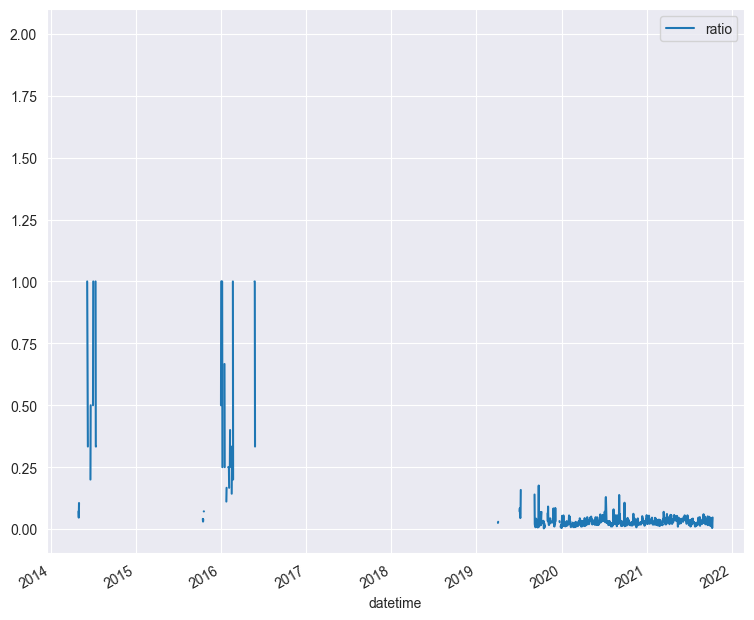

In [109]:
df_temp.plot(x='datetime', y='ratio', kind='line', figsize=(9,8))


<Axes: ylabel='celeb'>

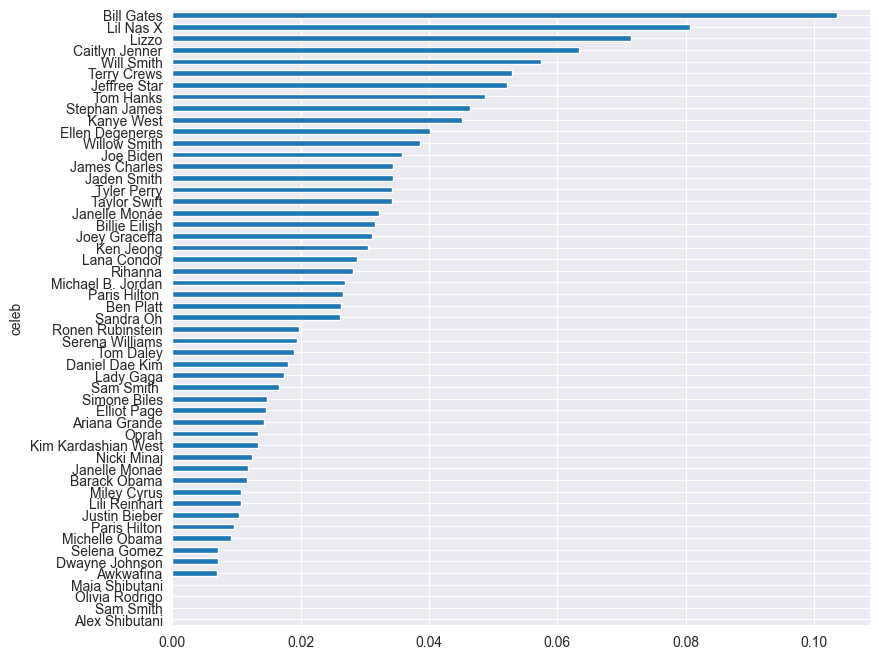

In [111]:
start_date = datetime.datetime.strptime('2020-07-01', '%Y-%m-%d')
moving_date_lst = [start_date+datetime.timedelta(i) for i in range(30)]
frames = []
for x in moving_date_lst:
    frames.append(df[df.datetime == x])

df_jul_celeb = pd.concat(frames).groupby(['comment_type', 'celeb']).username.count().reset_index().pivot(index='celeb', columns='comment_type', values='username').fillna(0)
df_jul_celeb['perc'] = df_jul_celeb['TOXIC']/(df_jul_celeb['TOXIC']+df_jul_celeb['NOT TOXIC'])
df_jul_celeb.sort_values('perc').perc.plot(kind='barh', figsize=(9,8))

In [112]:
df_temp1 = pd.concat(frames)
df_temp1 = df_temp1.groupby(['celeb', 'platform', 'comment_type']).username.count().reset_index(['celeb', 'platform', 'comment_type']).pivot(index='platform', columns=['celeb', 'comment_type'], values='username').fillna(0)
df_temp1

celeb        Alex Shibutani Ariana Grande       Awkwafina       Barack Obama  \
comment_type      NOT TOXIC     NOT TOXIC TOXIC NOT TOXIC TOXIC    NOT TOXIC   
platform                                                                       
facebook                0.0          22.0   0.0       0.0   0.0          0.0   
instagram              25.0        2665.0  24.0     268.0   1.0        325.0   
reddit                  0.0         196.0  14.0     113.0   1.0         59.0   
twitter                 0.0         292.0   8.0      43.0   1.0        295.0   
youtube                 0.0           0.0   0.0       0.0   0.0          0.0   

celeb              Ben Platt       Bill Gates  ... Tom Daley       Tom Hanks  \
comment_type TOXIC NOT TOXIC TOXIC  NOT TOXIC  ... NOT TOXIC TOXIC NOT TOXIC   
platform                                       ...                             
facebook       0.0       7.0   0.0        0.0  ...       0.0   0.0       0.0   
instagram      3.0     232.0  10.0    11291.0  ...     523.0   8.0       0.0   
reddit         0.0      95.0   1.0     4073.0  ...      12.0   2.0      46.0   
twitter        5.0     294.0   6.0      288.0  ...      33.0   1.0     286.0   
youtube        0.0       0.0   0.0        0.0  ...       0.0   0.0       0.0   

celeb              Tyler Perry       Will Smith        Willow Smith        
comment_type TOXIC   NOT TOXIC TOXIC  NOT TOXIC  TOXIC    NOT TOXIC TOXIC  
platform                                                                   
facebook       0.0         0.0   0.0        0.0    0.0          0.0   0.0  
instagram      0.0        46.0   0.0     1950.0  120.0         40.0   0.0  
reddit         3.0        33.0   0.0      133.0    1.0        274.0   9.0  
twitter       14.0       287.0  13.0      277.0   23.0        285.0  15.0  
youtube        0.0         0.0   0.0        0.0    0.0          0.0   0.0  

[5 rows x 102 columns]

In [113]:
temp_dict = {}
for celeb_col in {x for x, _ in df_temp1.columns}:
    if (celeb_col, 'TOXIC') not in df_temp1:
        temp_dict[celeb_col] = 0
    elif (celeb_col, 'NOT TOXIC') not in df_temp1:
        temp_dict[celeb_col] = 100
    else:
        temp_dict[celeb_col] = df_temp1[celeb_col, 'TOXIC'] / (df_temp1[celeb_col, 'TOXIC']+df_temp1[celeb_col, 'NOT TOXIC']) * 100

df_temp1 = pd.DataFrame(temp_dict, index=df_temp1.index)

In [114]:
df_temp1

,Janelle Monáe,Joey Graceffa,Lana Condor,Sandra Oh,Joe Biden,Terry Crews,Rihanna,Oprah,Paris Hilton,Ronen Rubinstein,...,Jaden Smith,James Charles,Paris Hilton,Tom Daley,Will Smith,Billie Eilish,Michelle Obama,Elliot Page,Kanye West,Tom Hanks
platform,,,,,,,,,,,,,,,,,,,,,
facebook,0.000000,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,NaN,NaN,...,4.000000,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,NaN
instagram,2.797203,2.318393,2.890173,3.317536,3.213443,4.657662,2.398082,0.733676,NaN,1.855288,...,2.631579,1.844091,0.963922,1.506591,5.797101,2.838428,0.802497,NaN,NaN,NaN
reddit,NaN,6.666667,0.000000,0.000000,6.267806,11.570248,9.523810,6.779661,NaN,NaN,...,8.888889,5.389222,0.000000,14.285714,0.746269,6.250000,0.000000,1.672241,11.111111,6.122449
twitter,3.666667,7.000000,0.000000,2.415459,4.666667,7.333333,4.666667,3.000000,2.666667,5.882353,...,5.000000,8.666667,NaN,2.941176,7.666667,4.000000,2.000000,0.000000,2.333333,4.666667
youtube,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.000000,NaN,NaN


## % токсичных комментариев на каждой платформе для каждой знаменитости в июле

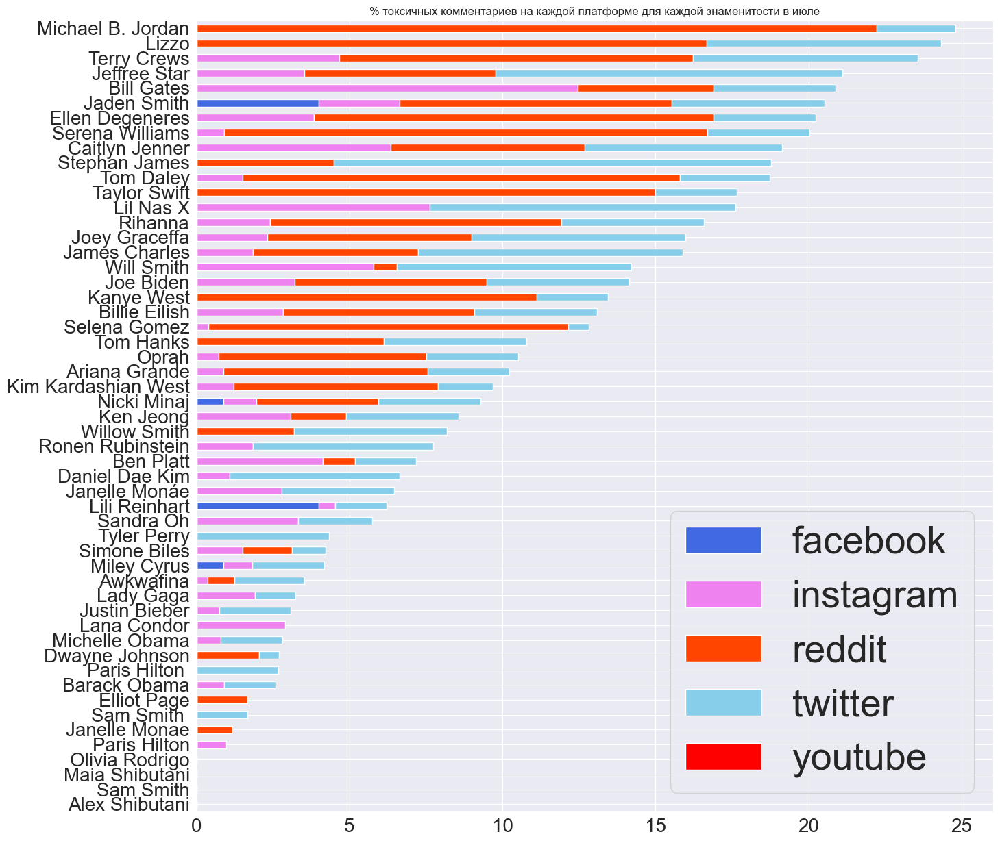

In [116]:
my_colors = ['royalblue', 'violet', 'orangered', 'skyblue', 'red']
pivot_dict = {}
for i, row in df_temp1.iterrows():
    pivot_dict[i] = row
df_pivot = pd.DataFrame(pivot_dict)
df_pivot['total'] = df_pivot.sum(axis=1)
df_pivot.sort_values('total')\
    .drop('total', axis=1)\
    .plot(kind='barh', 
        stacked=True, 
        figsize=(15,15), 
        color=my_colors, 
        title='% токсичных комментариев на каждой платформе для каждой знаменитости в июле')\

plt.legend(fontsize=40)
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)
plt.yticks(fontsize=20)
# plt.title('% Toxic Comments for each platform for each celebrity in Jul', fontdict = {'fontsize' : 40})
plt.savefig('images/% Toxic Comments for each platform for each celebrity in Jul')
plt.show()

In [117]:
df_temp.sort_values('ratio', ascending=False).head()

comment_type,datetime,NOT TOXIC,TOXIC,ratio
170,2015-02-01,1.0,2.0,2.0
265,2015-08-26,1.0,2.0,2.0
737,2018-09-01,1.0,1.0,1.0
324,2015-11-19,1.0,1.0,1.0
146,2014-12-18,1.0,1.0,1.0


In [118]:
df[df.datetime == datetime.datetime.strptime('2020-07-09', '%Y-%m-%d')].groupby(['platform', 'comment_type', 'celeb']).username.count().sort_values(ascending=False)

platform   comment_type  celeb          
instagram  NOT TOXIC     Bill Gates         2305
           TOXIC         Bill Gates          403
           NOT TOXIC     Rihanna             161
                         Tom Daley           156
                         Jaden Smith          96
                                            ... 
           TOXIC         Ellen Degeneres       1
                         Billie Eilish         1
                         Ariana Grande         1
           NOT TOXIC     Daniel Dae Kim        1
reddit     TOXIC         Willow Smith          1
Name: username, Length: 83, dtype: int64

In [119]:
list(df[df.datetime == datetime.datetime.strptime('2020-07-09', '%Y-%m-%d')].query("celeb == 'Bill Gates'").query("comment_type=='TOXIC'").comment)

['Who cares die already',
 'Cunt',
 'yal som hoe ass nggas if i catch ya ima do ya like ricky pussy',
 'You are disgusting  ',
 'Stupid',
 'Most hated man alive 🍕👹🌭💉🖕🏼   We want you to just die already take your family and associates with you to hell  ',
 'Take ur own vaccine fucking scum bag',
 'Stick your vaccines up your ass',
 'Mad person got to hell',
 'Your',
 'What is matter you will be in hell 👿buha Bill you are puppy of Satan beacuse your brain is it is brainwashed🖕🖕🖕 come on man wake up 🤮',
 'Shut up',
 'You',
 'You',
 'You',
 'You',
 '🤮🤮 you are sick and should be arrested     ',
 "I don't like you bill gates I hope you die and your family dies to",
 'UR SO FAKE BUDDY  This plandemic didn’t fool me',
 'Stick that💉 up your mothers ass you fucking coward',
 'Go to hell @thisisbillgates',
 'Die',
 'Kevin Kline  what happens with your penis  😂😂😂',
 'Take ur own vaccine fucking scum bag',
 'Stick your vaccines up your ass',
 'Mad person got to hell',
 'Your',
 'What is matter you

In [120]:
!pip install pytrends


[notice] A new release of pip available: 22.3.1 -> 23.3.2
[notice] To update, run: python.exe -m pip install --upgrade pip


## Анализ постов Билла Гейтса

In [121]:
from pytrends.request import TrendReq
pytrends = TrendReq(hl='en-US', tz=-480)
keywords = ["Bill Gates"]
pytrends.build_payload(keywords, geo='', timeframe='2020-07-01 2020-07-31', cat=0)
related_queries = pytrends.related_queries()
df_related_queries = related_queries['Bill Gates']['rising'].iloc[:5]

related_topics = pytrends.related_topics()
df_related_topics = related_topics['Bill Gates']['rising'].iloc[:5]




In [122]:
related_topics['Bill Gates']['rising']

,value,formattedValue,link,topic_mid,topic_title,topic_type
0,15500,Breakout,/trends/explore?q=/m/016d5m&date=2020-07-01+20...,/m/016d5m,Neocolonialism,Topic
1,1100,"+1,100%",/trends/explore?q=/m/0gvbw&date=2020-07-01+202...,/m/0gvbw,Pfizer,Pharmaceutical industry company
2,1000,"+1,000%",/trends/explore?q=/m/07gcbt&date=2020-07-01+20...,/m/07gcbt,Security hacker,Topic
3,750,+750%,/trends/explore?q=/m/0gw_xk8&date=2020-07-01+2...,/m/0gw_xk8,Ghislaine Maxwell,
4,300,+300%,/trends/explore?q=/m/0bmcfxn&date=2020-07-01+2...,/m/0bmcfxn,The World's Billionaires,Ranked list
5,300,+300%,/trends/explore?q=/m/0w2ztxm&date=2020-07-01+2...,/m/0w2ztxm,Moderna,Biotechnology company
6,250,+250%,/trends/explore?q=/g/12hhh4stc&date=2020-07-01...,/g/12hhh4stc,Entrepreneur,Career
7,200,+200%,/trends/explore?q=/m/04k4m3&date=2020-07-01+20...,/m/04k4m3,Anthony Fauci,Former Chief Medical Advisor to the President ...
8,200,+200%,/trends/explore?q=/m/07tgn&date=2020-07-01+202...,/m/07tgn,University of Oxford,"University in Oxford, England"
9,90,+90%,/trends/explore?q=/m/05l5n&date=2020-07-01+202...,/m/05l5n,Oxford,City in England


In [123]:
df_related_queries

,query,value
0,clay clark,10200
1,bill gates and moderna,550
2,elon musk twitter,400
3,moderna,400
4,hydroxychloroquine,350


In [124]:
df_related_topics

,value,formattedValue,link,topic_mid,topic_title,topic_type
0,15500,Breakout,/trends/explore?q=/m/016d5m&date=2020-07-01+20...,/m/016d5m,Neocolonialism,Topic
1,1100,"+1,100%",/trends/explore?q=/m/0gvbw&date=2020-07-01+202...,/m/0gvbw,Pfizer,Pharmaceutical industry company
2,1000,"+1,000%",/trends/explore?q=/m/07gcbt&date=2020-07-01+20...,/m/07gcbt,Security hacker,Topic
3,750,+750%,/trends/explore?q=/m/0gw_xk8&date=2020-07-01+2...,/m/0gw_xk8,Ghislaine Maxwell,
4,300,+300%,/trends/explore?q=/m/0bmcfxn&date=2020-07-01+2...,/m/0bmcfxn,The World's Billionaires,Ranked list


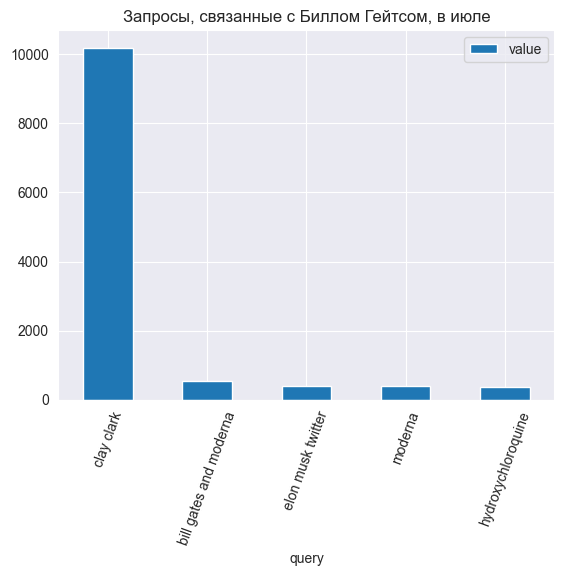

In [126]:
df_related_queries.plot.bar(x="query", y="value", rot=70, title="Запросы, связанные с Биллом Гейтсом, в июле")
plt.show(block=True)

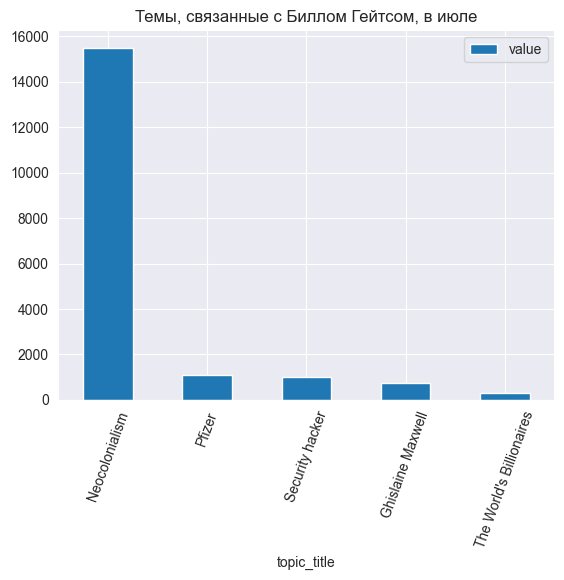

In [127]:
df_related_topics.plot.bar(x="topic_title", y="value", rot=70, title="Темы, связанные с Биллом Гейтсом, в июле")
plt.show(block=True)

In [129]:
df_cluster = df.drop(['username', 'datetime', 'comment', 'celeb', 'comment_type', 'ordinal'], axis=1)
df_cluster.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1629048 entries, 0 to 1629047
Data columns (total 11 columns):
 #   Column             Non-Null Count    Dtype  
---  ------             --------------    -----  
 0   likes              1629048 non-null  float64
 1   platform           1629048 non-null  object 
 2   TOXICITY           1629048 non-null  float64
 3   SEVERE_TOXICITY    1629048 non-null  float64
 4   SEXUALLY_EXPLICIT  1629048 non-null  float64
 5   THREAT             1629048 non-null  float64
 6   INSULT             1629048 non-null  float64
 7   IDENTITY_ATTACK    1629048 non-null  float64
 8   comment_type_n     1629048 non-null  float64
 9   length             1629048 non-null  int64  
 10  datenum            1629048 non-null  int64  
dtypes: float64(8), int64(2), object(1)
memory usage: 136.7+ MB


In [130]:
df_cluster=pd.get_dummies(df_cluster, columns = ['platform'])

In [131]:
df_cluster.skew()


likes                 236.491601
TOXICITY                3.870809
SEVERE_TOXICITY        23.019238
SEXUALLY_EXPLICIT       6.561869
THREAT                 35.844493
INSULT                  7.235177
IDENTITY_ATTACK        24.718913
comment_type_n          5.448896
length                 16.924191
datenum                -0.389065
platform_facebook       7.035266
platform_instagram      0.408505
platform_reddit         1.553580
platform_twitter        3.213656
platform_youtube        0.810368
dtype: float64

In [134]:
a_const = 0.00000000000000000000000000001
df_cluster['log_likes'] = np.log(df_cluster['likes']+a_const)
df_cluster['log_TOXICITY'] = np.log(df_cluster['TOXICITY']+a_const)
df_cluster['log_SEVERE_TOXICITY'] = np.log(df_cluster['SEVERE_TOXICITY']+a_const)
df_cluster['log_INSULT'] = np.log(df_cluster['INSULT']+a_const)
df_cluster['log_THREAT'] = np.log(df_cluster['THREAT']+a_const)
df_cluster['log_SEXUALLY_EXPLICIT'] = np.log(df_cluster['SEXUALLY_EXPLICIT']+a_const)
df_cluster['log_length'] = np.log(df_cluster['length']+a_const)


In [135]:
df_cluster.skew()


likes                    236.491601
TOXICITY                   3.870809
SEVERE_TOXICITY           23.019238
SEXUALLY_EXPLICIT          6.561869
THREAT                    35.844493
INSULT                     7.235177
IDENTITY_ATTACK           24.718913
comment_type_n             5.448896
length                    16.924191
datenum                   -0.389065
platform_facebook          7.035266
platform_instagram         0.408505
platform_reddit            1.553580
platform_twitter           3.213656
platform_youtube           0.810368
log_likes                  1.525009
log_TOXICITY               0.199425
log_SEVERE_TOXICITY       -0.035948
log_INSULT                 0.573003
log_THREAT                 1.172704
log_SEXUALLY_EXPLICIT      1.507344
log_length               -20.875632
dtype: float64

In [137]:
df_cluster=df_cluster[['datenum','platform_facebook','platform_instagram','platform_reddit','platform_twitter','platform_youtube','log_likes','log_TOXICITY','log_SEVERE_TOXICITY','log_INSULT','log_THREAT','log_SEXUALLY_EXPLICIT','log_length']]


In [138]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
scaler.fit(df_cluster)


StandardScaler()

In [139]:
df_scaled_np = scaler.transform(df_cluster)
df_prepared = pd.DataFrame(df_scaled_np, columns= df_cluster.columns)
df_prepared.head()


,datenum,platform_facebook,platform_instagram,platform_reddit,platform_twitter,platform_youtube,log_likes,log_TOXICITY,log_SEVERE_TOXICITY,log_INSULT,log_THREAT,log_SEXUALLY_EXPLICIT,log_length
0,0.029762,-0.13938,1.224899,-0.489466,-0.285762,-0.673785,1.999032,0.167775,0.534519,0.673093,1.616114,0.841226,0.702148
1,0.054654,-0.13938,1.224899,-0.489466,-0.285762,-0.673785,1.999032,0.031623,0.433003,0.091172,0.159730,-0.057093,-0.803438
2,0.104437,-0.13938,1.224899,-0.489466,-0.285762,-0.673785,-0.495275,2.998272,4.992622,4.038439,2.838668,4.566229,-0.146688
3,0.284903,-0.13938,1.224899,-0.489466,-0.285762,-0.673785,-0.495275,-0.803586,0.488498,-0.368650,0.083974,-0.012657,-0.803438
4,0.303572,-0.13938,1.224899,-0.489466,-0.285762,-0.673785,-0.495275,0.031623,0.433003,0.091172,0.159730,-0.057093,-0.040975


D:\projects\cource\venv\lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
C:\Users\for_i\AppData\Local\Temp\ipykernel_17700\4086814433.py:5: FutureWarning: Setting an item of incompatible dtype is deprecated and will raise in a future error of pandas. Value '21177624.00000041' has dtype incompatible with int64, please explicitly cast to a compatible dtype first.
  sse[i] = model.inertia_
D:\projects\cource\venv\lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)
D:\projects\cource\venv\lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change fro

1     2.117762e+07
2     1.767070e+07
3     1.515359e+07
4     1.309799e+07
5     1.135158e+07
6     9.668430e+06
7     8.640947e+06
8     7.794129e+06
9     7.114551e+06
10    6.522343e+06
11    6.133610e+06
12    5.832450e+06
13    5.588755e+06
14    5.309782e+06
dtype: float64


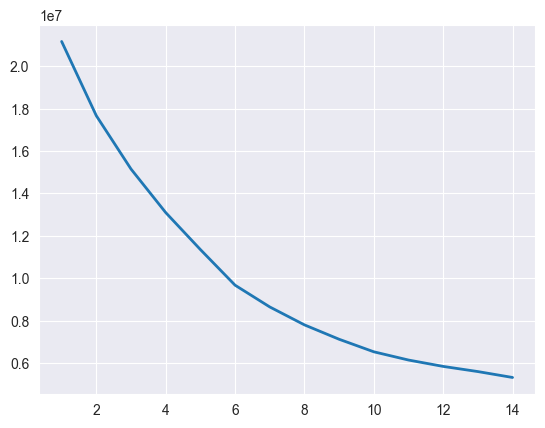

In [140]:
sse = pd.Series(range(14),index = range(1,15))
for i in range(1,15):
    model = KMeans(n_clusters = i, random_state=0)
    model.fit(df_prepared)
    sse[i] = model.inertia_
print(sse)
plt.plot(sse.index, sse, linewidth=2.0)

In [141]:
between_ss = []
for i in range(1,15):
    between_ss.append(((sse[1]-sse[i]) / sse[1]) * 100)
    
print(*between_ss, sep = "\n")


0.0
16.55956213569738
28.445289882921237
38.15176765232687
46.39822251194822
54.34601330161356
59.19775165327271
63.19639565475427
66.4053403920284
69.20172643258374
71.0373063443577
72.45937720658469
73.61009570138106
74.92739535802274


In [142]:
model = KMeans(n_clusters = 2, random_state=0)
model.fit(df_prepared)

D:\projects\cource\venv\lib\site-packages\sklearn\cluster\_kmeans.py:1416: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  super()._check_params_vs_input(X, default_n_init=10)


KMeans(n_clusters=2, random_state=0)

In [144]:
print("Атрибуты решения кластеризации для k=2:")
print("SSE :", round(model.inertia_, 1))
print("Количество итераций:" , model.n_iter_)
print("\nКластерные центры:" , model.cluster_centers_)

Атрибуты решения кластеризации для k=2:
SSE : 17670702.2
Количество итераций: 11

Кластерные центры: [[ 0.31660953 -0.06122093 -0.64061775  0.29437815  0.0614607   0.40941017
  -0.04887931 -0.50265449 -0.55998079 -0.52267372 -0.46597188 -0.4687209
   0.23909949]
 [-0.32328879  0.06251246  0.65413235 -0.30058841 -0.06275729 -0.41804717
   0.04991048  0.51325859  0.57179425  0.53370015  0.47580211  0.47860913
  -0.24414358]]


In [145]:
df['cluster'] = model.labels_
df['cluster'].value_counts()

cluster
0    824167
1    804881
Name: count, dtype: int64

In [146]:
model.cluster_centers_


array([[ 0.31660953, -0.06122093, -0.64061775,  0.29437815,  0.0614607 ,
         0.40941017, -0.04887931, -0.50265449, -0.55998079, -0.52267372,
        -0.46597188, -0.4687209 ,  0.23909949],
       [-0.32328879,  0.06251246,  0.65413235, -0.30058841, -0.06275729,
        -0.41804717,  0.04991048,  0.51325859,  0.57179425,  0.53370015,
         0.47580211,  0.47860913, -0.24414358]])

In [147]:
clust_means = pd.DataFrame(model.cluster_centers_, columns=df_prepared.columns)
clust_means

,datenum,platform_facebook,platform_instagram,platform_reddit,platform_twitter,platform_youtube,log_likes,log_TOXICITY,log_SEVERE_TOXICITY,log_INSULT,log_THREAT,log_SEXUALLY_EXPLICIT,log_length
0,0.316610,-0.061221,-0.640618,0.294378,0.061461,0.409410,-0.048879,-0.502654,-0.559981,-0.522674,-0.465972,-0.468721,0.239099
1,-0.323289,0.062512,0.654132,-0.300588,-0.062757,-0.418047,0.049910,0.513259,0.571794,0.533700,0.475802,0.478609,-0.244144


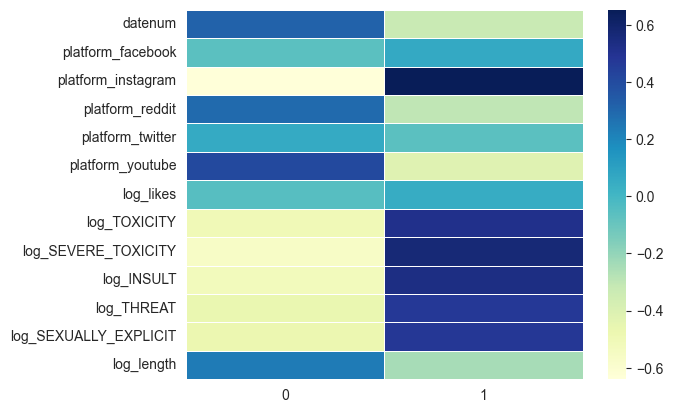

In [148]:
sns.heatmap(clust_means.T,  linewidths=.5, cmap="YlGnBu")
plt.savefig('images/cluster heatmap')

- <b>Cluster 0</b> The comments of this cluster mostly come from twitter and youtube.  <br />
The length of comments are reasonably high and the date posted is towards the end of the year. <br /> 
Toxicity, severe_toxicity, insult, profanity, threat, sexually_explicit and flirtation are relatively high

- <b>Cluster 1</b> The comments of this cluster mostly come from facebook, instagram and reddit.<br /> 
Toxicity, severe_toxicity, insult, profanity, threat, sexually_explicit and flirtation are relatively low.

# Дополнительные анализы

## Группировка по username

In [150]:
df.groupby('username').comment_type.value_counts().sort_values(ascending=False)


username      comment_type
jnnyms        NOT TOXIC       24853
himsju        NOT TOXIC       13746
iczcla        NOT TOXIC        9847
hh8xbg        NOT TOXIC        8340
gxm38h        NOT TOXIC        3576
                              ...  
Venom 2.0     NOT TOXIC           1
Venom Gaming  NOT TOXIC           1
Venom TG ff   NOT TOXIC           1
Venom garcia  NOT TOXIC           1
🪐flower       NOT TOXIC           1
Name: count, Length: 910844, dtype: int64

## Группировка по знаменитостям

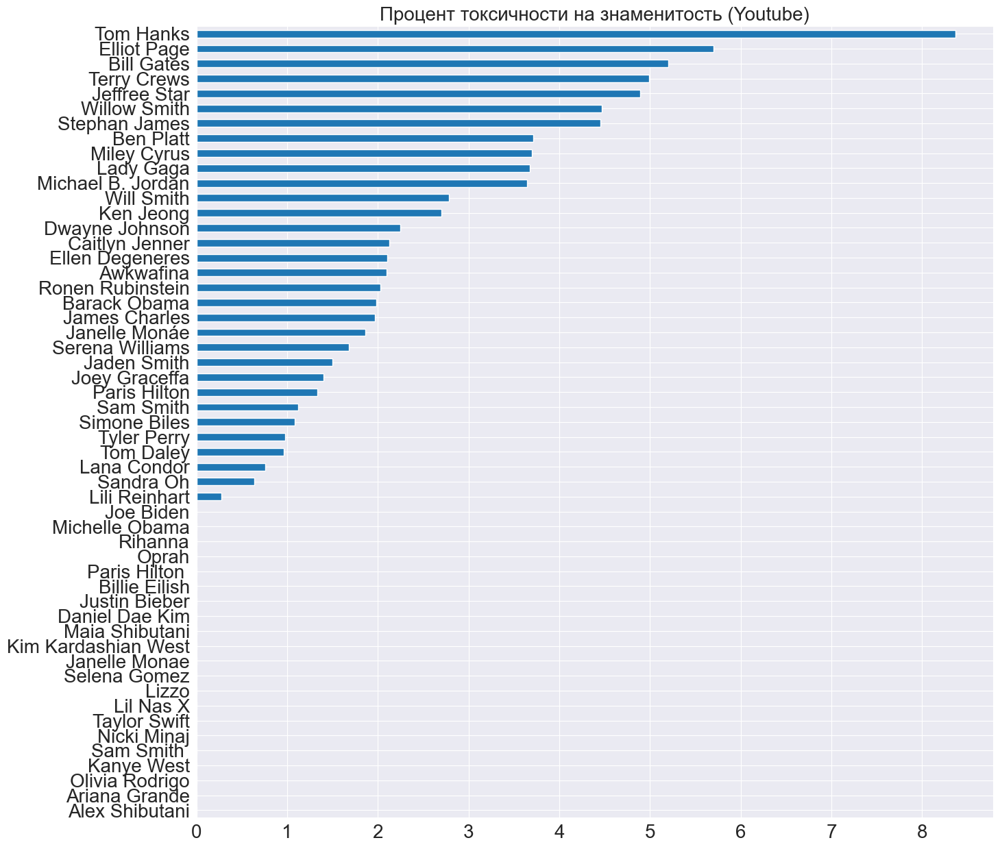

In [151]:
df_temp1 = df.groupby(['celeb', 'platform', 'comment_type'])\
                .username\
                .count()\
                .reset_index(['celeb', 'platform', 'comment_type'])\
                .pivot(index='platform', columns=['celeb', 'comment_type'], values='username')\
                .fillna(0)

temp_dict = {}
for celeb_col in {x for x, _ in df_temp1.columns}:
    temp_dict[celeb_col] = df_temp1[celeb_col, 'TOXIC'] / (df_temp1[celeb_col, 'TOXIC']+df_temp1[celeb_col, 'NOT TOXIC']) * 100
    temp_dict[celeb_col].fillna(0, inplace=True)

df_temp1 = pd.DataFrame(temp_dict, index=df_temp1.index)
df_temp1.loc['youtube'].sort_values().plot(kind='barh', figsize=(15,15), title='Процент токсичности на знаменитость (Youtube)')
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)
plt.title('Процент токсичности на знаменитость (Youtube)', fontdict = {'fontsize' : 20})
plt.savefig('images/Toxicity Percentage per celeb (Youtube)')
plt.show()

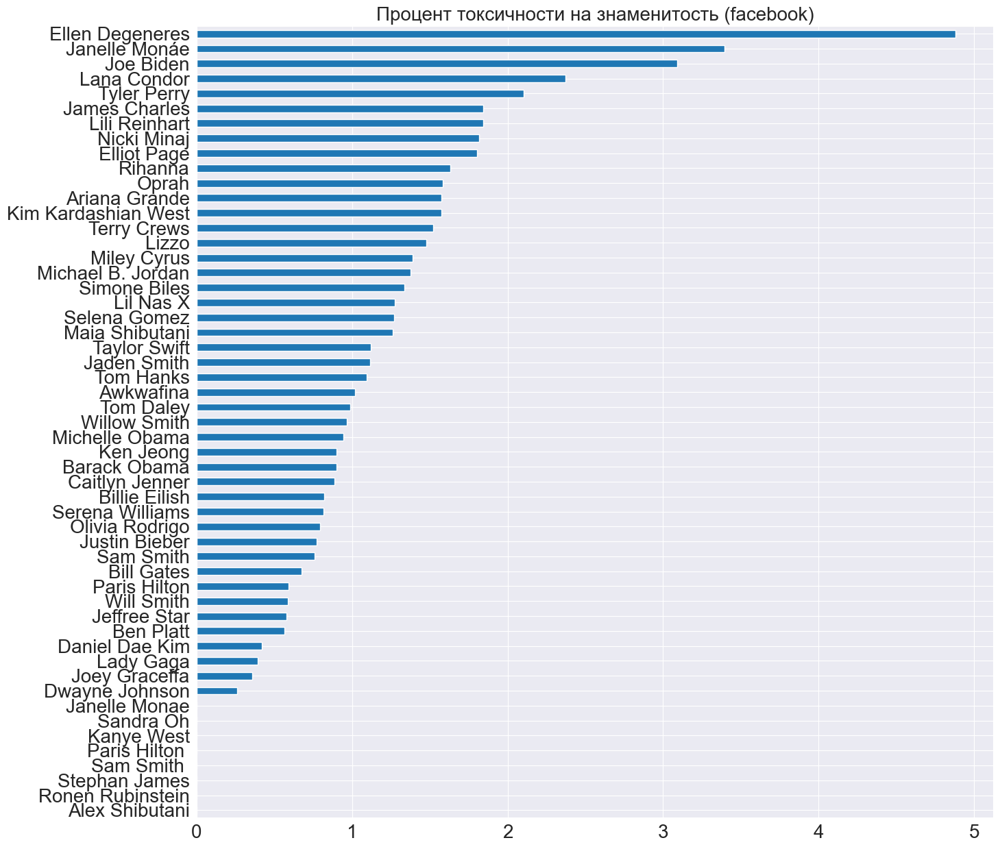

In [152]:
df_temp1.loc['facebook'].sort_values().plot(kind='barh', figsize=(15,15), title='Процент токсичности на знаменитость (facebook)')
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)
plt.title('Процент токсичности на знаменитость (facebook)', fontdict = {'fontsize' : 20})
plt.savefig('images/Toxicity Percentage per celeb (facebook)')
plt.show()

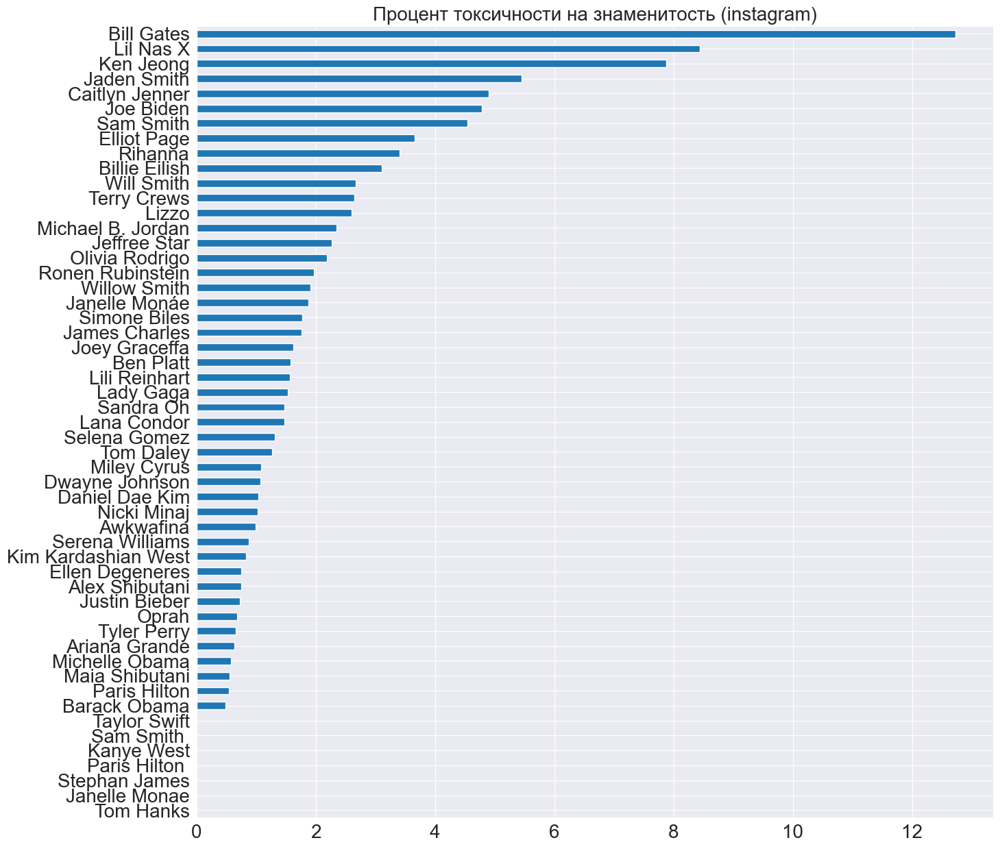

In [153]:
df_temp1.loc['instagram'].sort_values().plot(kind='barh', figsize=(15,15))
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)
plt.title('Процент токсичности на знаменитость (instagram)', fontdict = {'fontsize' : 20})
plt.savefig('images/Toxicity Percentage per celeb (instagram)')
plt.show()

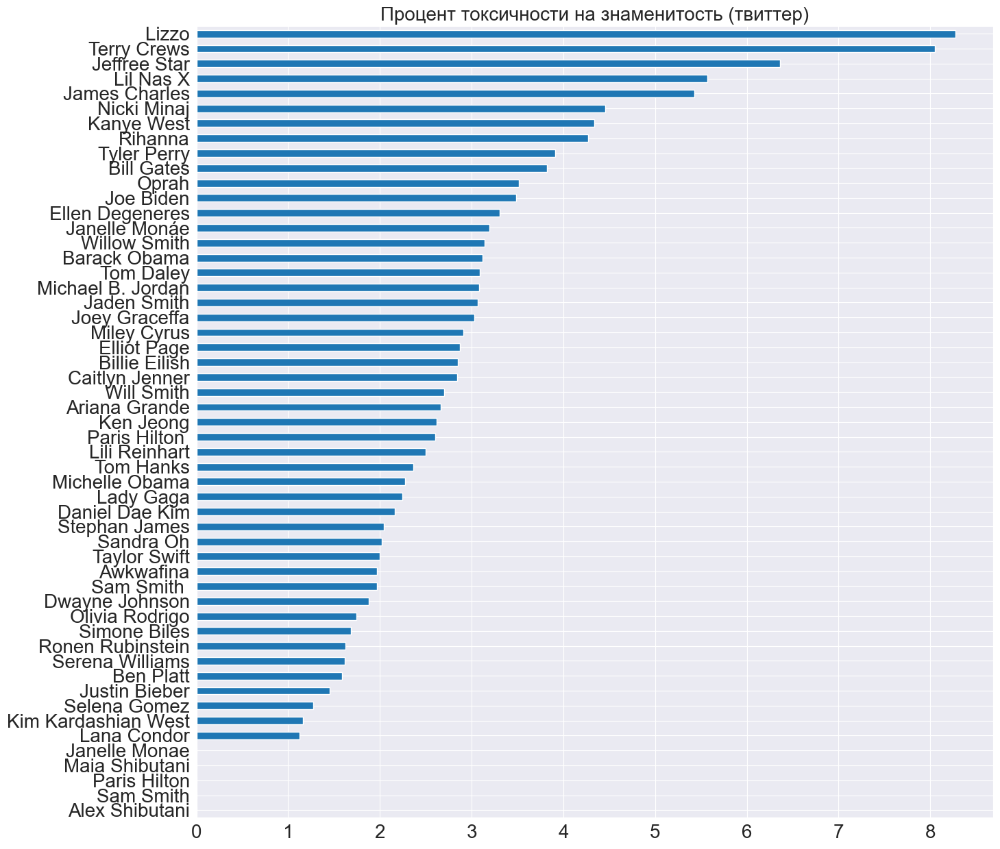

In [154]:
df_temp1.loc['twitter'].sort_values().plot(kind='barh', figsize=(15,15))
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)
plt.title('Процент токсичности на знаменитость (твиттер)', fontdict = {'fontsize' : 20})
plt.savefig('images/Toxicity Percentage per celeb (twitter)')
plt.show()

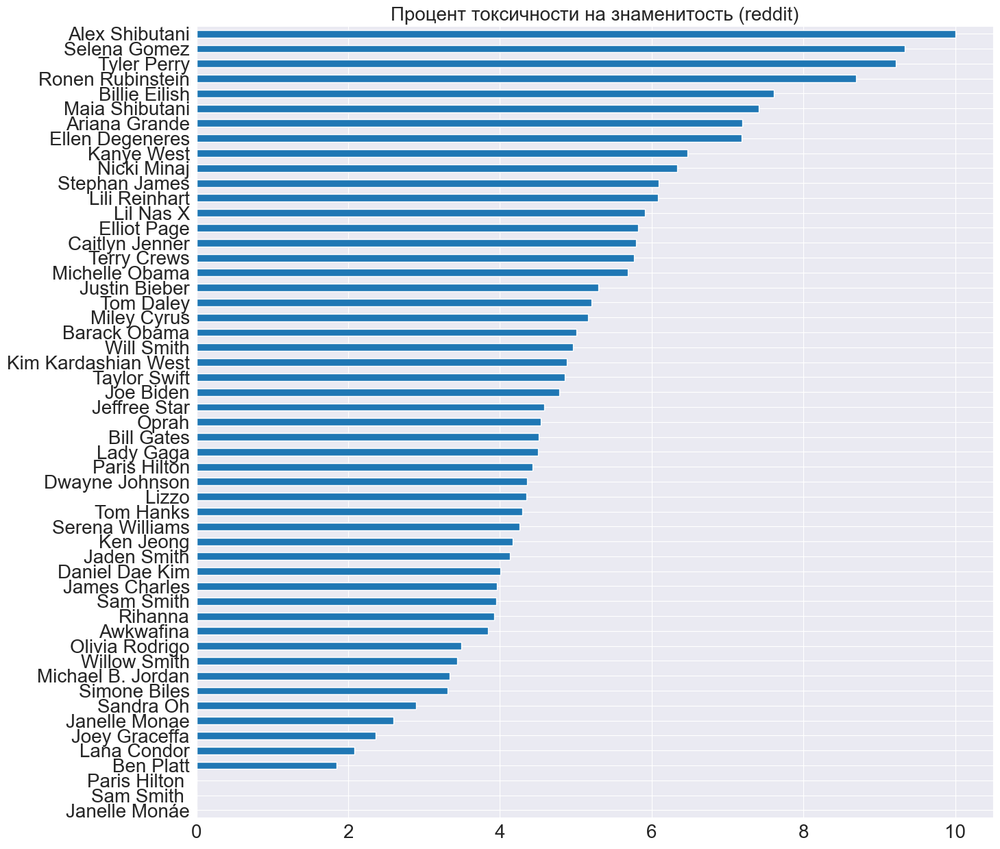

In [155]:
df_temp1.loc['reddit'].sort_values().plot(kind='barh', figsize=(15,15))
plt.xticks(fontsize=20)
plt.yticks(fontsize=20)
plt.title('Процент токсичности на знаменитость (reddit)', fontdict = {'fontsize' : 20})
plt.savefig('images/Toxicity Percentage per celeb (reddit)')
plt.show()

facebook ['Ellen Degeneres', 'Janelle Monáe', 'Joe Biden', 'Lana Condor', 'Tyler Perry']
instagram ['Bill Gates', 'Lil Nas X', 'Ken Jeong', 'Jaden Smith', 'Caitlyn Jenner']
reddit ['Alex Shibutani', 'Selena Gomez', 'Tyler Perry', 'Ronen Rubinstein', 'Billie Eilish']
twitter ['Lizzo', 'Terry Crews', 'Jeffree Star', 'Lil Nas X', 'James Charles']
youtube ['Tom Hanks', 'Elliot Page', 'Bill Gates', 'Terry Crews', 'Jeffree Star']


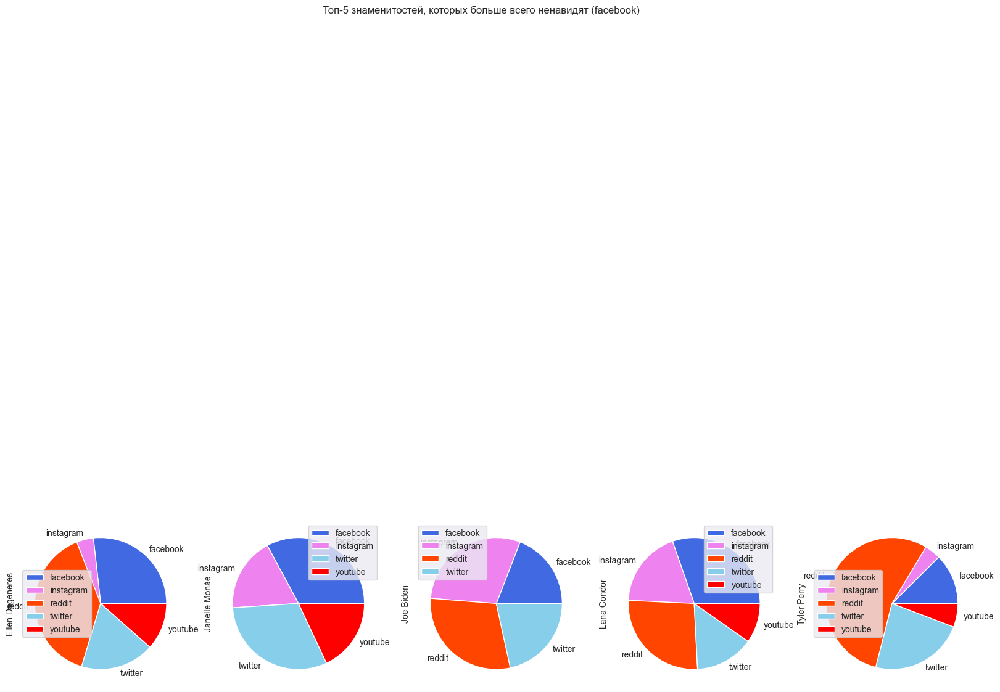

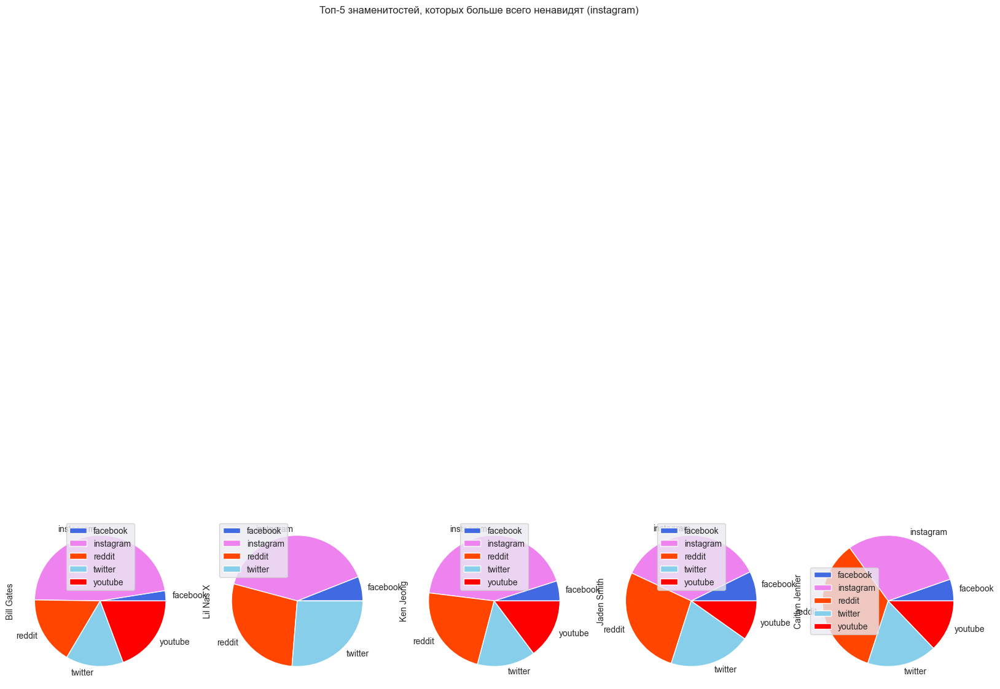

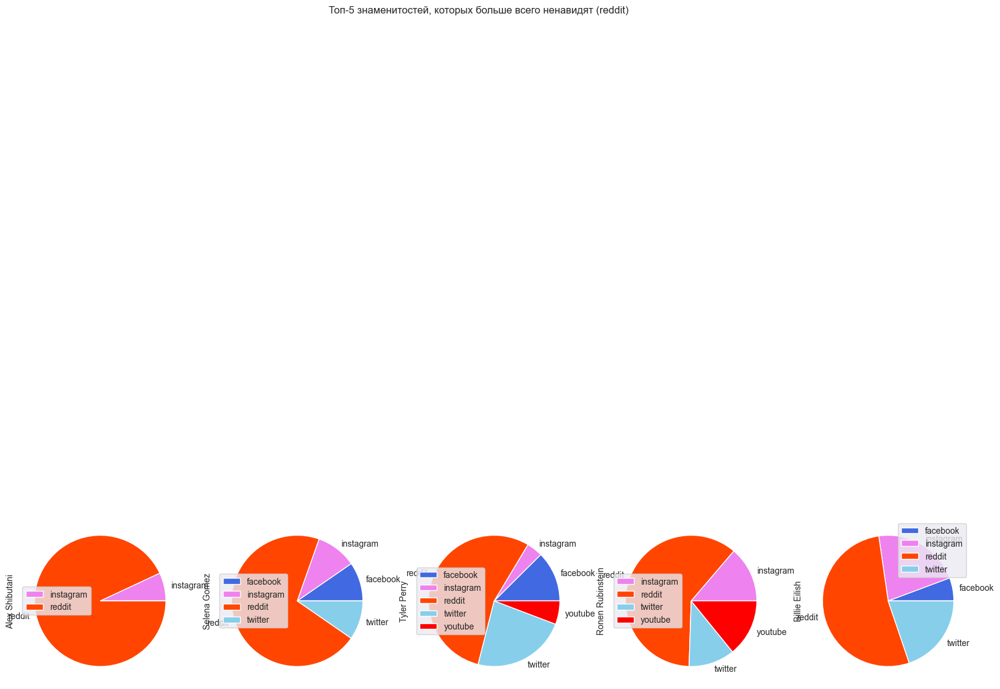

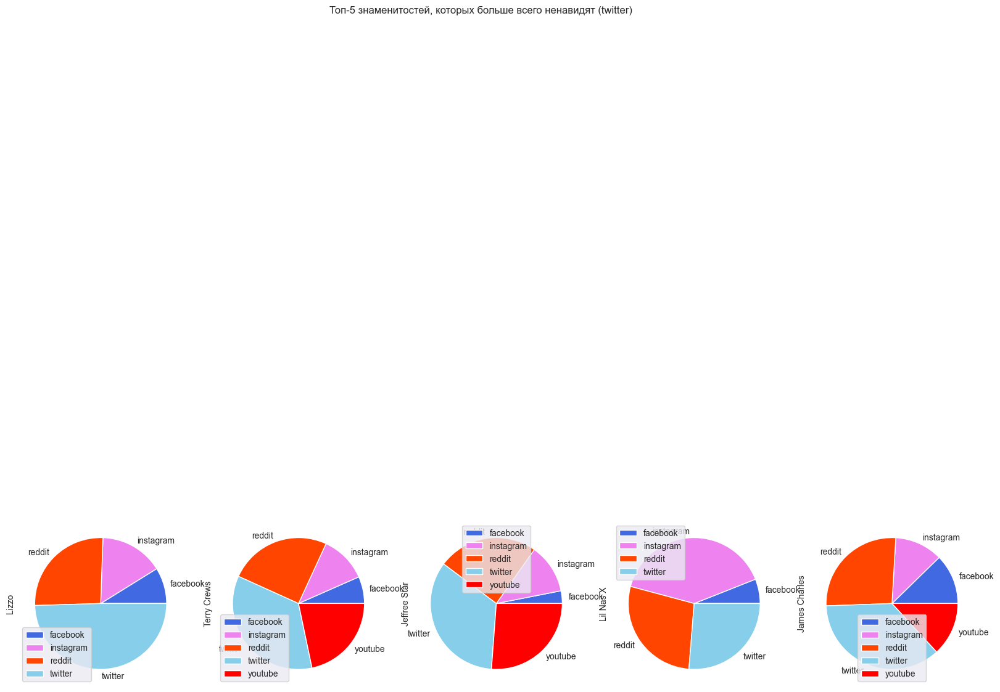

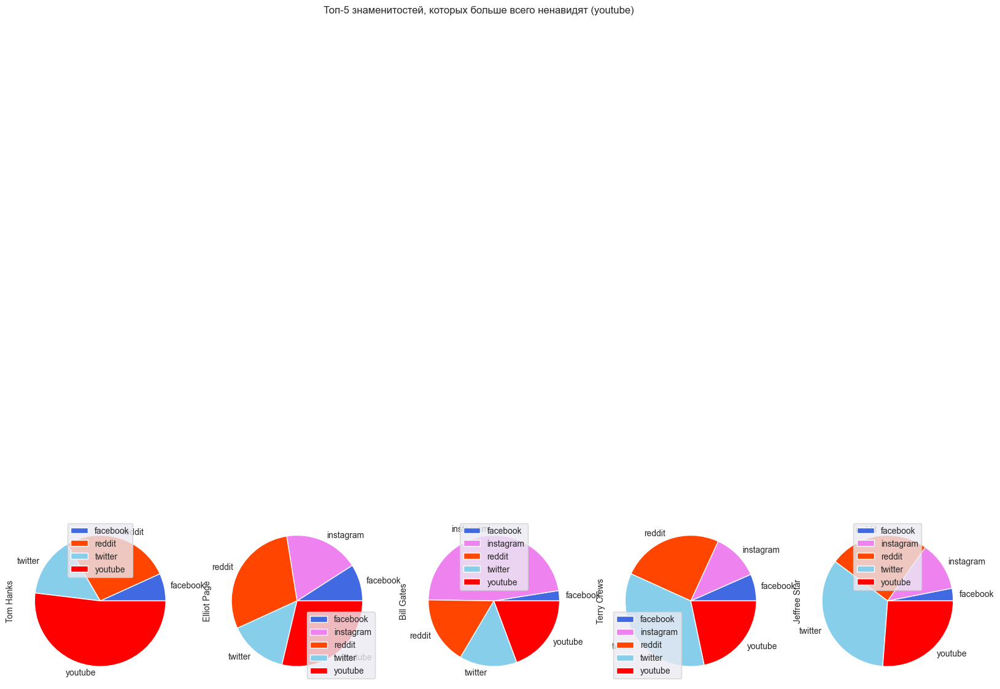

In [156]:
df_temp1 = df.groupby(['celeb', 'platform', 'comment_type'])\
                .username\
                .count()\
                .reset_index(['celeb', 'platform', 'comment_type'])\
                .pivot(index='platform', columns=['celeb', 'comment_type'], values='username')\
                .fillna(0)

temp_dict = {}
for celeb_col in {x for x, _ in df_temp1.columns}:
    temp_dict[celeb_col] = df_temp1[celeb_col, 'TOXIC'] / (df_temp1[celeb_col, 'TOXIC']+df_temp1[celeb_col, 'NOT TOXIC']) * 100
    temp_dict[celeb_col].fillna(0, inplace=True)

df_temp1 = pd.DataFrame(temp_dict, index=df_temp1.index)

my_colors = ['royalblue', 'violet', 'orangered', 'skyblue', 'red']
top_each_plat = {}

platform = df_temp1.index
for plat in platform:
    top5 = [x for x, _ in sorted(temp_dict.items(), key=lambda x:x[1][plat], reverse=True)[:5]]
    top_each_plat[plat] = top5[0]
    print(plat, top5)
    df_temp1[top5]\
        .plot\
        .pie(subplots=True, figsize=(20,20), colors = my_colors, title=f'Топ-5 знаменитостей, которых больше всего ненавидят ({plat})')
    plt.savefig(f'images/Top 5 Celeb receive most hate ({plat})')
plt.show()

In [157]:
df[df.celeb == 'Bill Gates'].query('comment_type == "TOXIC"').comment

516160                       Eat a dick with rona on the tip
516164                                   Ya momma ain't shit
516165                                 Who cares die already
516180                                           ROT IN HELL
516184                                           BITCH ASS  
                                 ...                        
1594382    Wohl eher die Verzweifelung  die da aus mir sp...
1594408                                      Still get dirty
1594423    > Natürlich profitieren vereinzelte Firmen dav...
1594476    Ja  schon  Vielleicht nicht direkt über die We...
1594531    I don't think the people coming with corporate...
Name: comment, Length: 4625, dtype: object

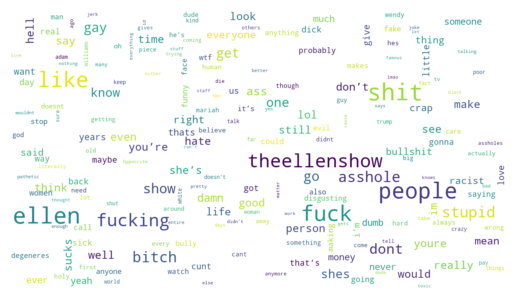

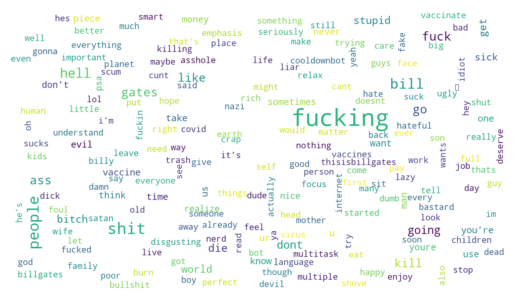

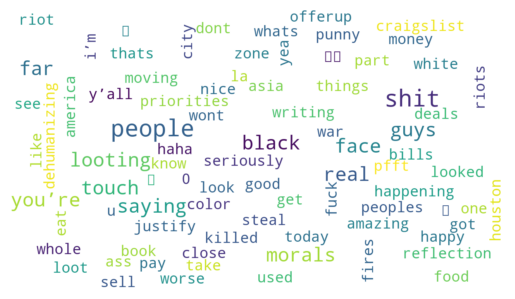

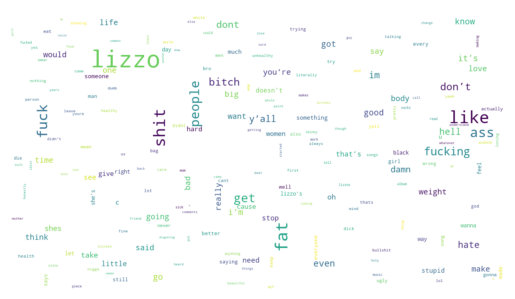

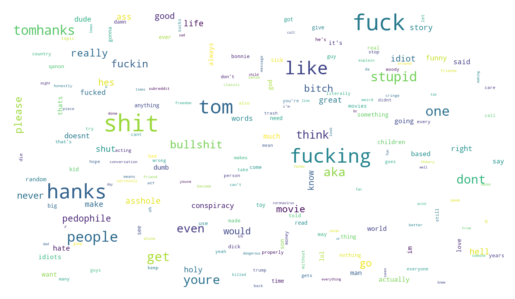

In [158]:
for plat in top_each_plat:
    name = top_each_plat[plat]
    top_df = df[df.celeb == name].query('comment_type == "TOXIC"')

    top_df['clean_text_1'] = top_df['comment'].apply(clean_text_round1)
    top_df['clean_text_1'] = top_df['clean_text_1'].apply(clean_text_round2)

    result = count_words_from_dataframe(top_df)
    sorted_dic = ((k, result[k]) for k in sorted(result, key=result.get, reverse=True))

    os.makedirs('plot', exist_ok=True)
    os.makedirs('word_counts', exist_ok=True)

    file_path = f'./word_counts/{name}_unigram_counts.csv'
    pd.DataFrame(list(sorted_dic)).to_csv(file_path, index=False)


    file_path = f'./word_counts/{name}_unigram_counts.csv'
    fullTermsDict = read_word_count_file(file_path)
    outputfile = f"./plot/wordcloud_count_unigram_{name}"
    makeImage(fullTermsDict, outputfile)


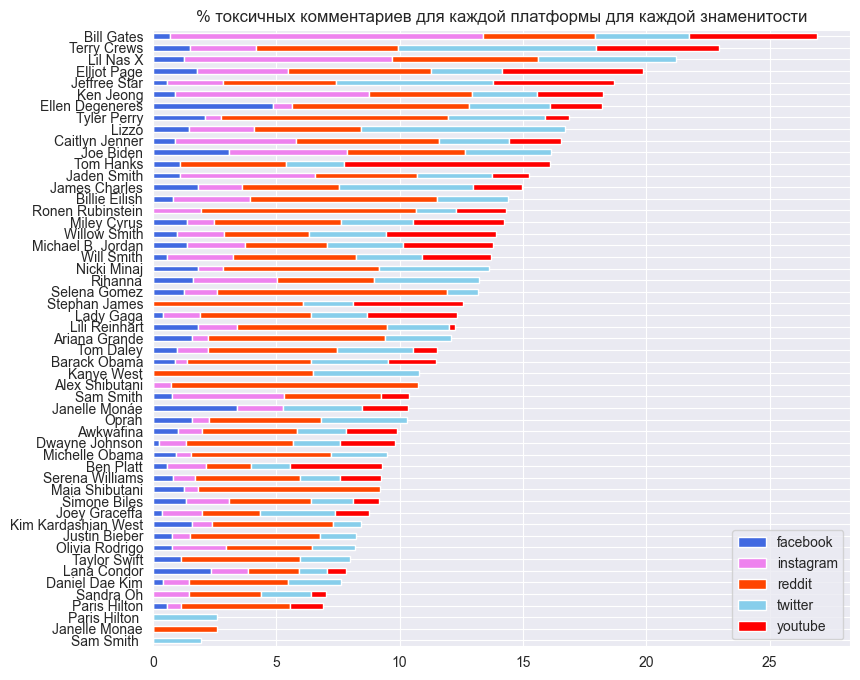

In [159]:
pivot_dict = {}
for i, row in df_temp1.iterrows():
    pivot_dict[i] = row
df_pivot = pd.DataFrame(pivot_dict)
df_pivot['total'] = df_pivot.sum(axis=1)
df_pivot.sort_values('total')\
    .drop('total', axis=1)\
    .plot(kind='barh', 
        stacked=True, 
        figsize=(9,8), 
        color=my_colors, 
        title='% токсичных комментариев для каждой платформы для каждой знаменитости')\
    .get_figure()\
    .savefig('images/% Toxic Comments for each platform for each celebrity')

### Среднее

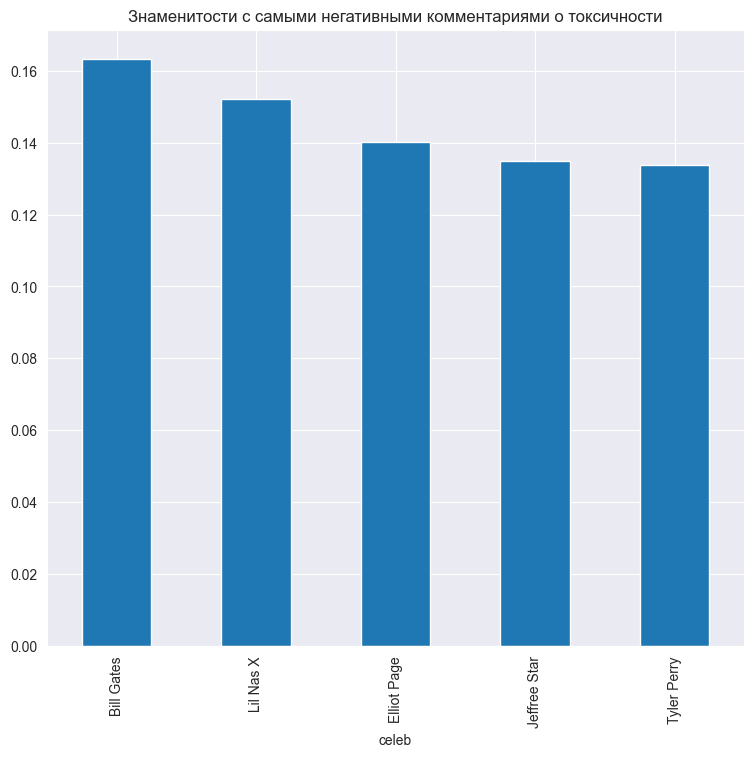

In [160]:
df.groupby('celeb')\
    .TOXICITY\
    .mean()\
    .sort_values(ascending=False)\
    .head()\
    .plot(kind='bar', figsize=(9,8), title='Знаменитости с самыми негативными комментариями о токсичности')\
    .get_figure()\
    .savefig('images/Celebrities with highest mean Toxic comments')


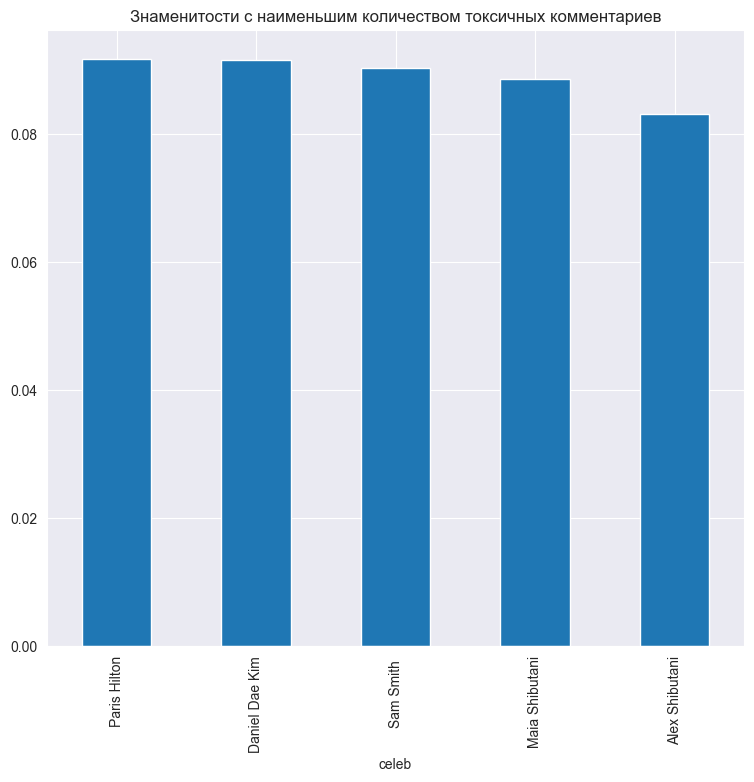

In [161]:
df.groupby('celeb')\
    .TOXICITY\
    .mean()\
    .sort_values(ascending=False)\
    .tail()\
    .plot(kind='bar', figsize=(9,8), title='Знаменитости с наименьшим количеством токсичных комментариев')\
    .get_figure()\
    .savefig('images/Celebrities with lowest mean Toxic comments')

## Группировка по Расе/ЛГБТ

In [162]:
celeb_excel_df =  pd.read_excel(f'List_of_Celebrities.xlsx').iloc[:50]
celeb_remarks_dict = celeb_excel_df[['Name', 'Remarks']].set_index('Name').to_dict()['Remarks']
celeb_race_dict = celeb_excel_df[['Name', 'Race']].set_index('Name').to_dict()['Race']
celeb_gender_dict = celeb_excel_df[['Name', 'Gender']].set_index('Name').to_dict()['Gender']


In [165]:
# Предположим, что celeb_remarks_dict и celeb_race_dict уже определены

# Обработка ключей словарей (убираем пробелы и приводим к нижнему регистру)
celeb_remarks_dict = {k.strip().lower(): v for k, v in celeb_remarks_dict.items()}
celeb_race_dict = {k.strip().lower(): v for k, v in celeb_race_dict.items()}

# Обработка значений в DataFrame
df['celeb'] = df['celeb'].str.strip().str.lower()

# Применение словарей
df['remarks'] = df['celeb'].apply(lambda x: celeb_remarks_dict.get(x, 'Unknown'))
df['race'] = df['celeb'].apply(lambda x: celeb_race_dict.get(x, 'Unknown'))


In [168]:
df_grpby_cat = df.groupby(['remarks', 'comment_type'])\
                        .username\
                        .count()\
                        .reset_index(['remarks', 'comment_type'])\
                        .pivot(index='remarks', columns='comment_type', values='username')

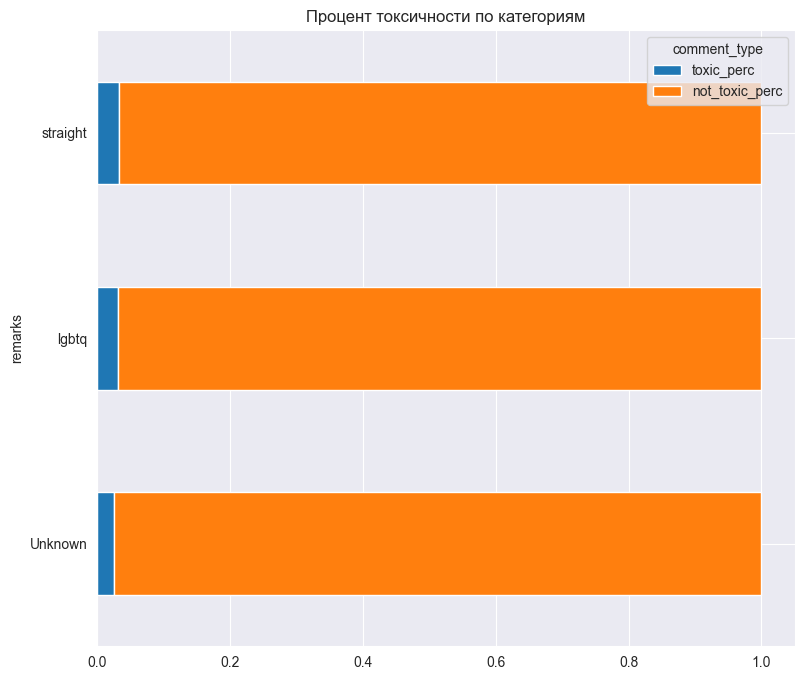

In [169]:
df_grpby_cat['toxic_perc'] = df_grpby_cat['TOXIC'] / (df_grpby_cat['TOXIC'] + df_grpby_cat['NOT TOXIC'])
df_grpby_cat['not_toxic_perc'] = df_grpby_cat['NOT TOXIC'] / (df_grpby_cat['TOXIC'] + df_grpby_cat['NOT TOXIC'])
df_grpby_cat

df_grpby_cat.drop(['NOT TOXIC', 'TOXIC'], axis=1)\
    .sort_values('toxic_perc')\
    .plot(kind='barh', stacked=True, figsize=(9,8), title='Процент токсичности по категориям')\
    .get_figure()\
    .savefig('images/Toxicity Percentage by Categories')

In [172]:
df_grpby_race = df.groupby(['race', 'comment_type'])\
                        .username\
                        .count()\
                        .reset_index(['race', 'comment_type'])\
                        .pivot(index='race', columns='comment_type', values='username')

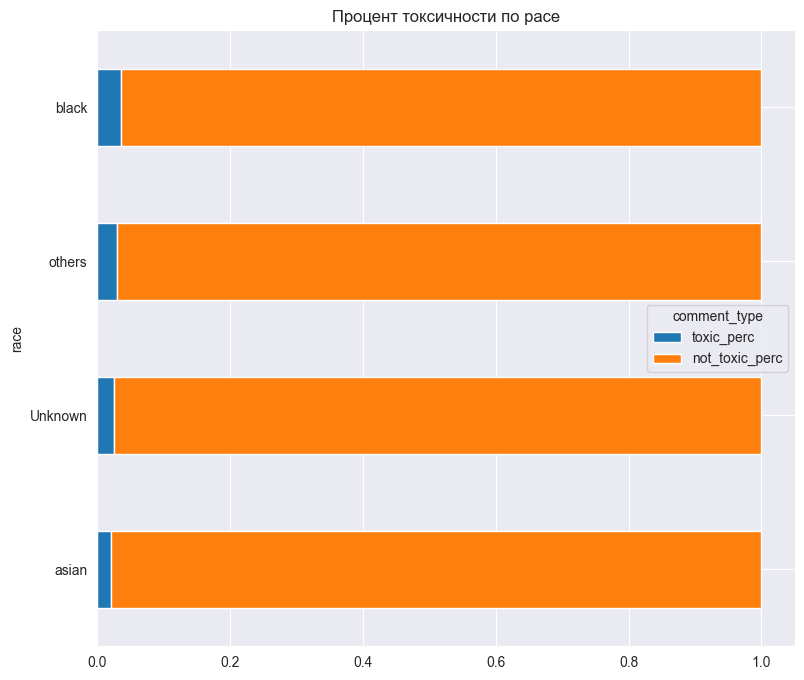

In [173]:
df_grpby_race['toxic_perc'] = df_grpby_race['TOXIC'] / (df_grpby_race['TOXIC'] + df_grpby_race['NOT TOXIC'])
df_grpby_race['not_toxic_perc'] = df_grpby_race['NOT TOXIC'] / (df_grpby_race['TOXIC'] + df_grpby_race['NOT TOXIC'])
df_grpby_race

df_grpby_race.drop(['NOT TOXIC', 'TOXIC'], axis=1)\
    .sort_values('toxic_perc')\
    .plot(kind='barh', stacked=True, figsize=(9,8), title='Процент токсичности по расе')\
    .get_figure()\
    .savefig('images/Toxicity Percentage by Race')

# Сети

## Сеть Twitter

In [181]:
df_twitter = df[df.platform == 'twitter']
lst = list(set([(row.username, row.celeb) for _, row in df_twitter.iterrows()]))
len(lst)

99173

In [182]:
G = nx.Graph()
G.add_edges_from(lst)

num_nodes = nx.number_of_nodes(G)
num_edges = nx.number_of_edges(G)
print(num_nodes)
print(num_edges)

91490
99173


In [183]:
# Compute degree centrality
dc = nx.degree_centrality(G)


In [184]:
top10_degree = sorted(dc.items(), key=lambda x:x[1], reverse=True)[50:50+10]
top10_degree = tuple(x for x, y in top10_degree)
top10_degree

('AndyVermaut',
 'ETCanada',
 'eRadioUS',
 'medicinehelp',
 'naija_reports',
 'people',
 'SweetAnette96',
 'sweetquebecer',
 'then24dotcom',
 'The_News_DIVA')

In [186]:
lst = []
for node in top10_degree:
    lst.append(df_twitter[df_twitter.username == node].comment_type.value_counts())
pd.DataFrame(lst, index=top10_degree)

comment_type,NOT TOXIC
AndyVermaut,36
ETCanada,30
eRadioUS,21
medicinehelp,26
naija_reports,20
people,19
SweetAnette96,22
sweetquebecer,19
then24dotcom,17
The_News_DIVA,20


In [206]:
pd.set_option('display.max_colwidth', 150)
df_twitter[df_twitter.username == 'ETCanada'].query("comment_type == 'TOXIC'")
df_twitter.to_csv("twitter_graph.csv")

In [188]:
graph_username = 'alt43studio'
graph_password = 'saltHackG01'
graphistry.register(api=3, protocol="https", server="hub.graphistry.com", username=graph_username, password=graph_password)

In [ ]:
# run code below or just visit this website: twitter: https://hub.graphistry.com/graph/graph.html?dataset=0a6704f7b7a34ef88e2b6429777dd4c5
graphistry.edges(df_twitter, 'username', 'celeb').plot()

## Сеть Youtube

In [190]:
df_youtube = df[df.platform == 'youtube']
lst = list(set([(row.username, row.celeb) for _, row in df_youtube.iterrows()]))
len(lst)

395123

In [191]:
G = nx.Graph()
G.add_edges_from(lst)

num_nodes = nx.number_of_nodes(G)
num_edges = nx.number_of_edges(G)
print(num_nodes)
print(num_edges)

371224
395123


In [192]:
# Compute degree centrality
dc = nx.degree_centrality(G)


In [193]:
top10_degree = sorted(dc.items(), key=lambda x:x[1], reverse=True)[50:50+10]
top10_degree = tuple(x for x, y in top10_degree)
top10_degree

('Jane Doe', 'S', 'Andrew', 'Angel', 'Sarah', 'A M', 'A A', 'John', 'L', 'Sam')

In [194]:
lst = []
for node in top10_degree:
    lst.append(df_youtube[df_youtube.username == node].comment_type.value_counts())
pd.DataFrame(lst, index=top10_degree)

comment_type,NOT TOXIC,TOXIC
Jane Doe,19.0,1.0
S,47.0,1.0
Andrew,30.0,2.0
Angel,56.0,2.0
Sarah,53.0,4.0
A M,28.0,NaN
A A,47.0,2.0
John,22.0,2.0
L,56.0,2.0
Sam,62.0,3.0


In [196]:
df_youtube[df_youtube.username == 'sam'].query("comment_type == 'TOXIC'")
df_youtube.to_csv("youtube_graph.csv")

In [ ]:
# run code below or just visit this website: youtube: https://hub.graphistry.com/graph/graph.html?dataset=b9ca1b8ed1394d5b80eb1c12ff3b8e70
graphistry.edges(df_youtube, 'username', 'celeb').plot()

## Сеть Facebook

In [199]:
df_facebook = df[df.platform == 'facebook']
lst = list(set([(row.username, row.celeb) for _, row in df_facebook.iterrows()]))
len(lst)

2157

In [200]:
G = nx.Graph()
G.add_edges_from(lst)

num_nodes = nx.number_of_nodes(G)
num_edges = nx.number_of_edges(G)
print(num_nodes)
print(num_edges)

772
2157


In [201]:
# Compute degree centrality
dc = nx.degree_centrality(G)


In [202]:
top10_degree = sorted(dc.items(), key=lambda x:x[1], reverse=True)[50:50+10]
top10_degree = tuple(x for x, y in top10_degree)
top10_degree

('92304305160_10164577979740161',
 '303142040045638_1362428534116978',
 '61614240588_10158247689390589',
 '22433917219_10158978564087220',
 '7961985974_10157765906150975',
 '10376464573_10159188197654574',
 '26012002239_10159557129782240',
 '7961985974_10157767725540975',
 '123287957731763_2880035215390343',
 '1323627617769877_2057344604398171')

In [203]:
lst = []
for node in top10_degree:
    lst.append(df_facebook[df_facebook.username == node].comment_type.value_counts())
pd.DataFrame(lst, index=top10_degree)

comment_type,NOT TOXIC,TOXIC
92304305160_10164577979740161,49.0,NaN
303142040045638_1362428534116978,43.0,NaN
61614240588_10158247689390589,43.0,4.0
22433917219_10158978564087220,49.0,NaN
7961985974_10157765906150975,49.0,NaN
10376464573_10159188197654574,49.0,NaN
26012002239_10159557129782240,41.0,2.0
7961985974_10157767725540975,45.0,NaN
123287957731763_2880035215390343,46.0,1.0
1323627617769877_2057344604398171,51.0,NaN


In [205]:
df_facebook[df_facebook.username == '121492378267_10159815072973268'].query("comment_type == 'TOXIC'")
df_facebook.to_csv("facebook_graph.csv")

In [ ]:
# run code below or just visit this website: facebook: https://hub.graphistry.com/graph/graph.html?dataset=fc4d664ef94b4f4cbacbe46a7dbb5564
graphistry.edges(df_facebook, 'username', 'celeb').plot()

## Сеть Instagram

In [207]:
df_instagram = df[df.platform=='instagram']
lst = list(set([(row.username, row.celeb) for _, row in df_instagram.iterrows()]))
len(lst)

442704

In [208]:
G = nx.Graph()
G.add_edges_from(lst)

num_nodes = nx.number_of_nodes(G)
num_edges = nx.number_of_edges(G)
print(num_nodes)
print(num_edges)

427315
442704


In [209]:
# Compute degree centrality
dc = nx.degree_centrality(G)

In [210]:
top10_degree = sorted(dc.items(), key=lambda x:x[1], reverse=True)[50:50+10]
top10_degree = tuple(x for x, y in top10_degree)
top10_degree

('kro.sprinkles',
 '2484672048dailyscripture',
 'nazrien_ozir',
 'cydkort',
 'play.u4it_xo',
 'steve_rotolo',
 'fandel_scott',
 'galibarkel',
 'zander_tibz',
 'goodvibespeoplez')

In [211]:
lst = []
for node in top10_degree:
    lst.append(df_instagram[df_instagram.username == node].comment_type.value_counts())
pd.DataFrame(lst, index=top10_degree)

comment_type,NOT TOXIC
kro.sprinkles,17
2484672048dailyscripture,37
nazrien_ozir,14
cydkort,39
play.u4it_xo,15
steve_rotolo,23
fandel_scott,16
galibarkel,18
zander_tibz,24
goodvibespeoplez,23


In [212]:
df_instagram[df_instagram.username == 'kro.sprinkles'].query("comment_type == 'TOXIC'")
df_instagram.to_csv("instagram_graph.csv")


In [ ]:
# run code below or just visit this website: instagram: https://hub.graphistry.com/graph/graph.html?dataset=000ff602328742dc911069fd559559da
graphistry.edges(df_instagram, 'username', 'celeb').plot()

## Сеть Reddit

In [214]:
df_reddit = df[df.platform == 'reddit']
lst = list(set([(row.username, row.celeb) for _, row in df_reddit.iterrows()]))
len(lst)

11612

In [215]:
G = nx.Graph()
G.add_edges_from(lst)

num_nodes = nx.number_of_nodes(G)
num_edges = nx.number_of_edges(G)
print(num_nodes)
print(num_edges)

11067
11612


In [216]:
# Compute degree centrality
dc = nx.degree_centrality(G)


In [217]:
celeb_excel_df.Name

0               Ben Platt
1          Caitlyn Jenner
2         Ellen Degeneres
3             Elliot Page
4           James Charles
5           Janelle Monáe
6            Jeffree Star
7           Joey Graceffa
8               Lady Gaga
9               Lil Nas X
10          Lili Reinhart
11            Miley Cyrus
12       Ronen Rubinstein
13              Sam Smith
14              Tom Daley
15          Ariana Grande
16          Billie Eilish
17           Selena Gomez
18           Barack Obama
19            Jaden Smith
20             Kanye West
21                  Lizzo
22      Michael B. Jordan
23         Michelle Obama
24            Nicki Minaj
25                  Oprah
26                Rihanna
27        Serena Williams
28           Simone Biles
29          Stephan James
30            Terry Crews
31            Tyler Perry
32           Willow Smith
33             Will Smith
34         Dwayne Johnson
35         Daniel Dae Kim
36              Sandra Oh
37         Alex Shibutani
38         M

In [218]:
# top10_degree = sorted(dc.items(), key=lambda x:x[1], reverse=True)[50:50+10]
top10_degree = sorted(dc.items(), key=lambda x:x[1], reverse=True)
top10_degree = tuple(x for x, y in top10_degree if x not in list(celeb_excel_df.Name))
top10_degree = top10_degree[:10]
top10_degree

('jeffree star',
 'will smith',
 'james charles',
 'bill gates',
 'sam smith',
 'tom hanks',
 'dwayne johnson',
 'jaden smith',
 'terry crews',
 'sandra oh')

In [219]:
lst = []
for node in top10_degree:
    lst.append(df_reddit[df_reddit.username == node].comment_type.value_counts())
pd.DataFrame(lst, index=top10_degree)

comment_type
jeffree star
will smith
james charles
bill gates
sam smith
tom hanks
dwayne johnson
jaden smith
terry crews
sandra oh


In [221]:
df_reddit[df_reddit.username == 'kmo7u2'].query("comment_type == 'TOXIC'")
df_reddit.to_csv("reddit_graph.csv")

In [ ]:
# run code below or just visit this website: reddit: https://hub.graphistry.com/graph/graph.html?dataset=4d66f2ee0d424fd7a0b80438fc7f705a
graphistry.edges(df_reddit, 'username', 'celeb').plot()